<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_7_layers_Earl_Stop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/MyDrive/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(7):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    keras.callbacks.EarlyStopping(
    monitor = 'val_IoU',
    patience = 20,
    verbose=1,
    mode = 'max',
    restore_best_weights=True,
    start_from_epoch = 100
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
25/26 [===========================>..] - ETA: 0s - loss: 41.4545 - IoU: 0.0343
Epoch 1: val_IoU improved from -inf to 0.00094, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 30ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


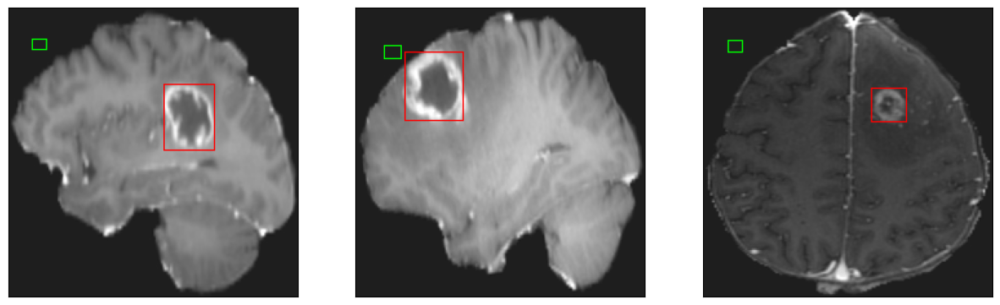

26/26 [==============================] - 21s 197ms/step - loss: 40.7367 - IoU: 0.0365 - val_loss: 55.2636 - val_IoU: 9.4204e-04
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 23.0944 - IoU: 0.0968
Epoch 2: val_IoU improved from 0.00094 to 0.00577, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 6ms/step
4


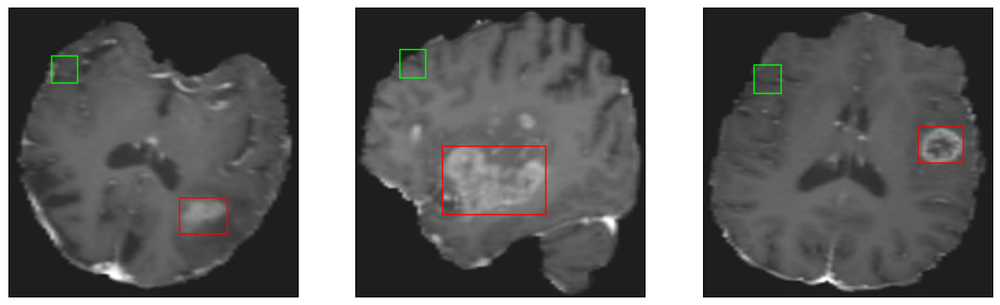

26/26 [==============================] - 3s 114ms/step - loss: 23.0944 - IoU: 0.0968 - val_loss: 43.5783 - val_IoU: 0.0058
Epoch 3/200
25/26 [===========================>..] - ETA: 0s - loss: 19.8707 - IoU: 0.1544
Epoch 3: val_IoU improved from 0.00577 to 0.02770, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


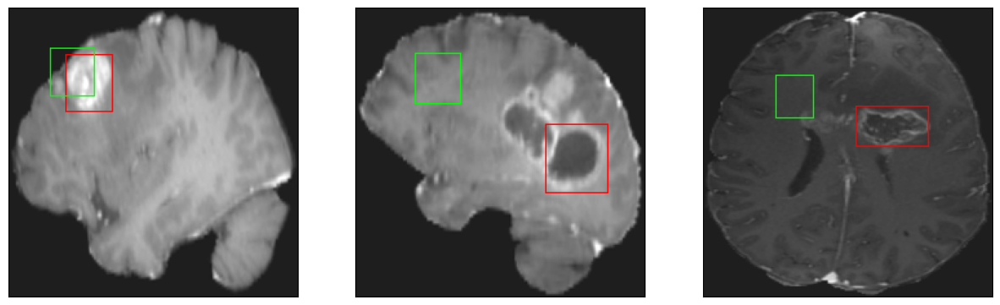

26/26 [==============================] - 2s 95ms/step - loss: 19.7481 - IoU: 0.1571 - val_loss: 32.2490 - val_IoU: 0.0277
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 15.2531 - IoU: 0.2593
Epoch 4: val_IoU improved from 0.02770 to 0.04651, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


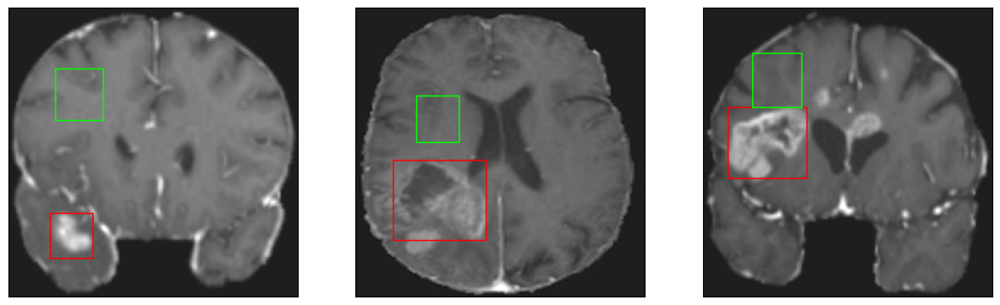

26/26 [==============================] - 2s 96ms/step - loss: 15.3180 - IoU: 0.2582 - val_loss: 26.1224 - val_IoU: 0.0465
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 13.7172 - IoU: 0.3027
Epoch 5: val_IoU improved from 0.04651 to 0.16580, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


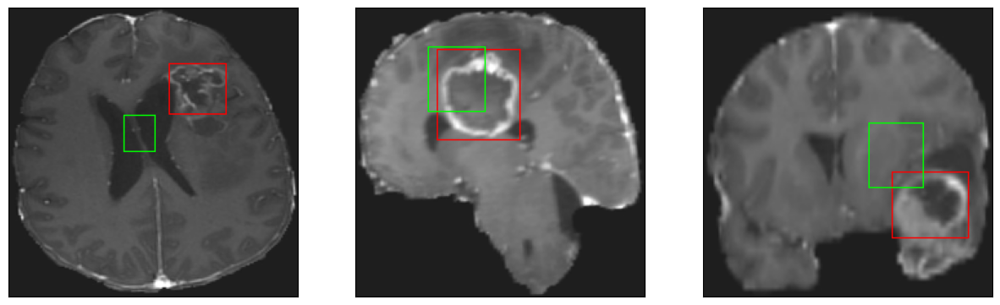

26/26 [==============================] - 3s 99ms/step - loss: 13.7172 - IoU: 0.3027 - val_loss: 17.6997 - val_IoU: 0.1658
Epoch 6/200
25/26 [===========================>..] - ETA: 0s - loss: 12.5885 - IoU: 0.3334
Epoch 6: val_IoU did not improve from 0.16580
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


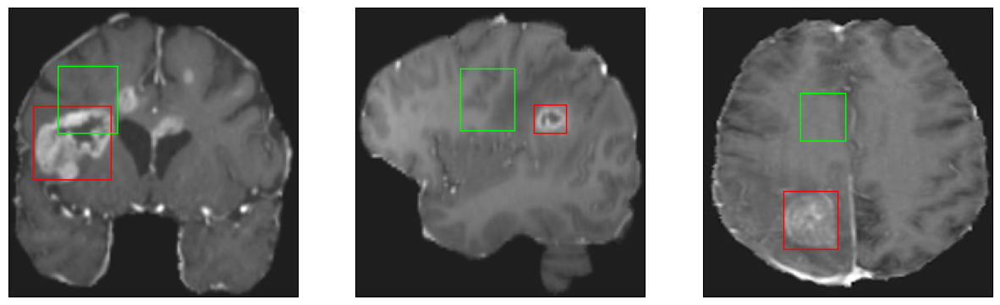

26/26 [==============================] - 2s 92ms/step - loss: 12.5877 - IoU: 0.3328 - val_loss: 20.2235 - val_IoU: 0.1153
Epoch 7/200
25/26 [===========================>..] - ETA: 0s - loss: 12.1512 - IoU: 0.3549
Epoch 7: val_IoU improved from 0.16580 to 0.24492, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


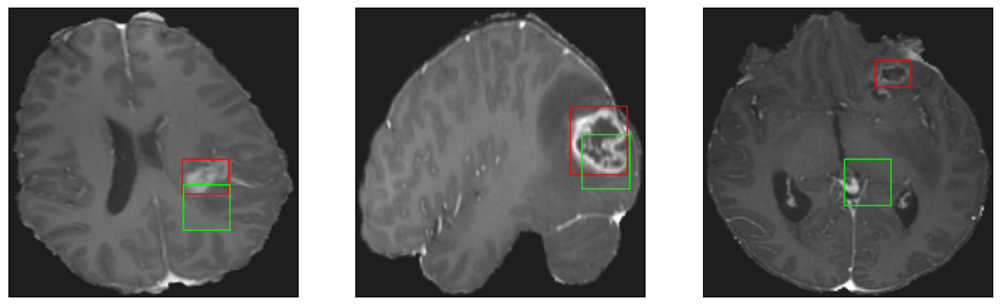

26/26 [==============================] - 3s 112ms/step - loss: 12.1691 - IoU: 0.3540 - val_loss: 15.2588 - val_IoU: 0.2449
Epoch 8/200
25/26 [===========================>..] - ETA: 0s - loss: 11.0759 - IoU: 0.3696
Epoch 8: val_IoU improved from 0.24492 to 0.33366, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


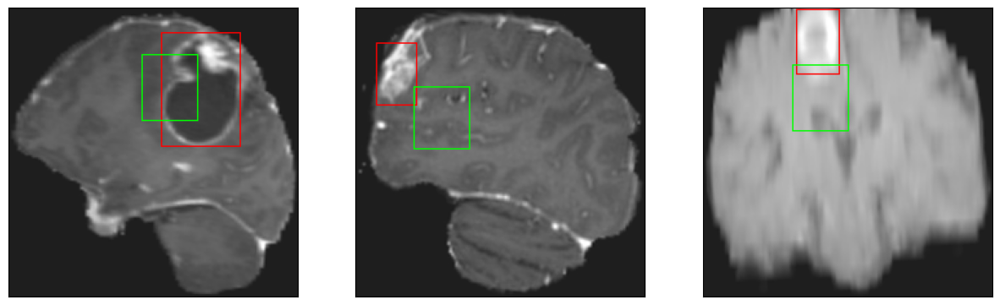

26/26 [==============================] - 3s 112ms/step - loss: 11.1093 - IoU: 0.3696 - val_loss: 13.4637 - val_IoU: 0.3337
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 11.2085 - IoU: 0.3753
Epoch 9: val_IoU improved from 0.33366 to 0.33930, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


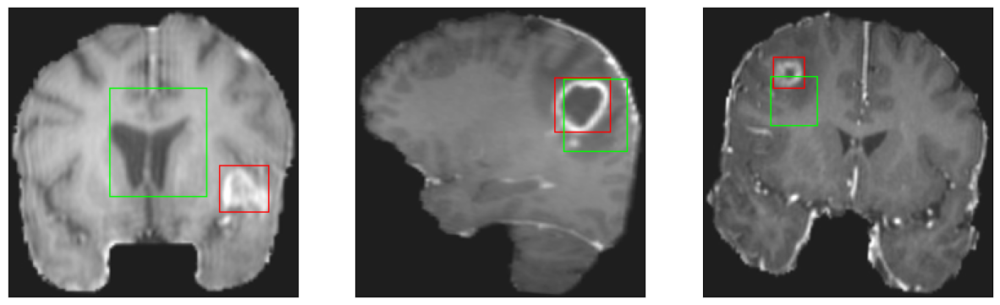

26/26 [==============================] - 3s 120ms/step - loss: 11.2085 - IoU: 0.3753 - val_loss: 13.3324 - val_IoU: 0.3393
Epoch 10/200
25/26 [===========================>..] - ETA: 0s - loss: 10.2429 - IoU: 0.4005
Epoch 10: val_IoU improved from 0.33930 to 0.34821, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


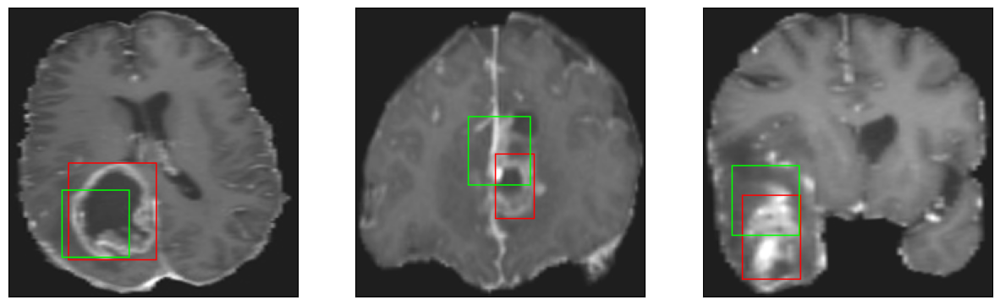

26/26 [==============================] - 3s 100ms/step - loss: 10.3314 - IoU: 0.4015 - val_loss: 12.2618 - val_IoU: 0.3482
Epoch 11/200
25/26 [===========================>..] - ETA: 0s - loss: 9.5102 - IoU: 0.4261
Epoch 11: val_IoU improved from 0.34821 to 0.35681, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


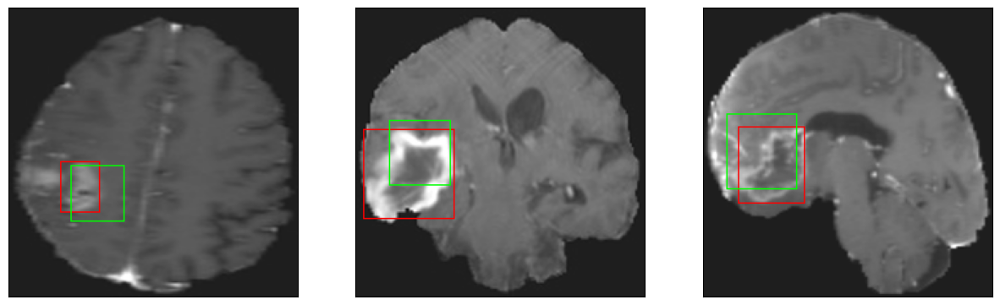

26/26 [==============================] - 3s 103ms/step - loss: 9.5054 - IoU: 0.4292 - val_loss: 12.3429 - val_IoU: 0.3568
Epoch 12/200
25/26 [===========================>..] - ETA: 0s - loss: 9.2737 - IoU: 0.4365
Epoch 12: val_IoU did not improve from 0.35681
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


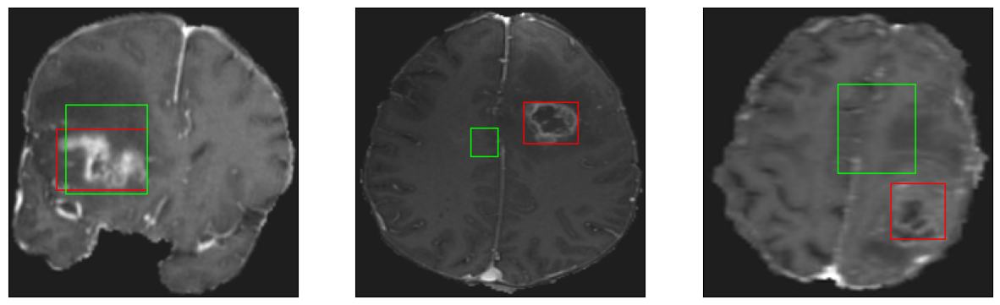

26/26 [==============================] - 3s 96ms/step - loss: 9.2436 - IoU: 0.4369 - val_loss: 18.3311 - val_IoU: 0.2317
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 8.8216 - IoU: 0.4488
Epoch 13: val_IoU did not improve from 0.35681
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4


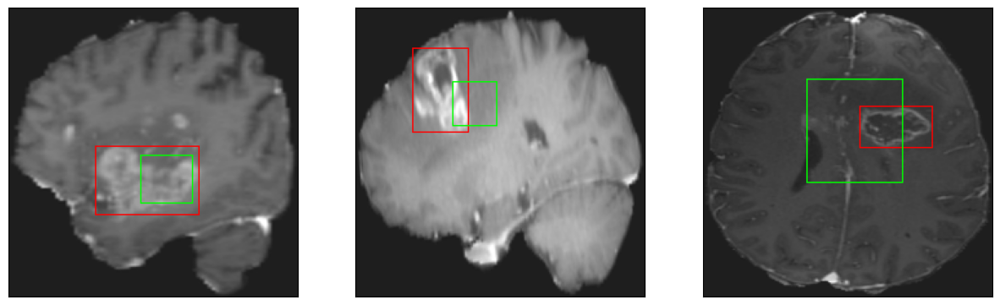

26/26 [==============================] - 3s 122ms/step - loss: 8.8216 - IoU: 0.4488 - val_loss: 14.5892 - val_IoU: 0.2233
Epoch 14/200
25/26 [===========================>..] - ETA: 0s - loss: 8.8540 - IoU: 0.4476
Epoch 14: val_IoU did not improve from 0.35681
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


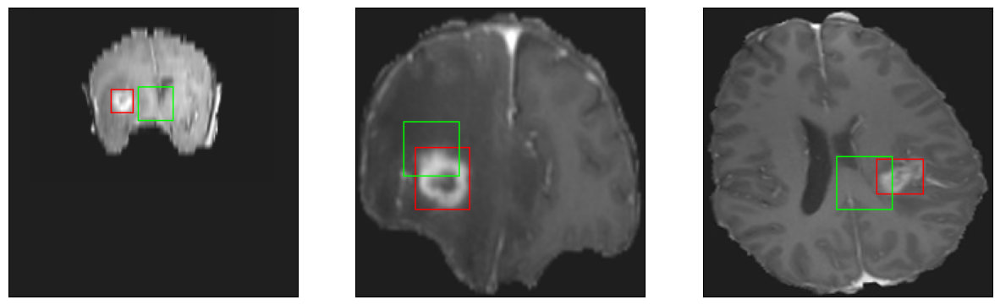

26/26 [==============================] - 2s 93ms/step - loss: 8.8655 - IoU: 0.4447 - val_loss: 18.0285 - val_IoU: 0.1797
Epoch 15/200
25/26 [===========================>..] - ETA: 0s - loss: 8.5904 - IoU: 0.4609
Epoch 15: val_IoU did not improve from 0.35681
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


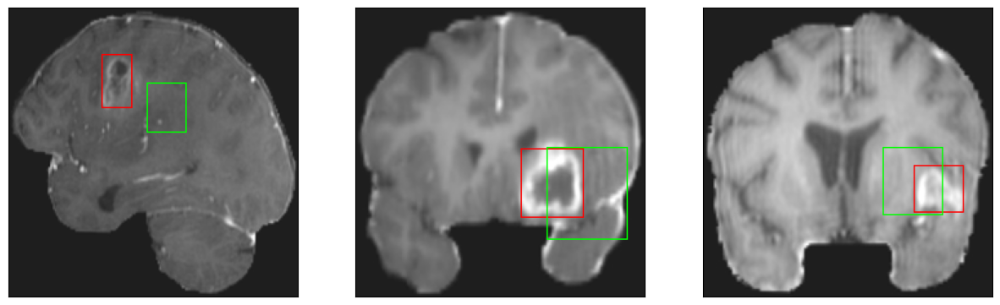

26/26 [==============================] - 2s 89ms/step - loss: 8.5621 - IoU: 0.4602 - val_loss: 12.2618 - val_IoU: 0.3440
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 8.2950 - IoU: 0.4621
Epoch 16: val_IoU improved from 0.35681 to 0.35975, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


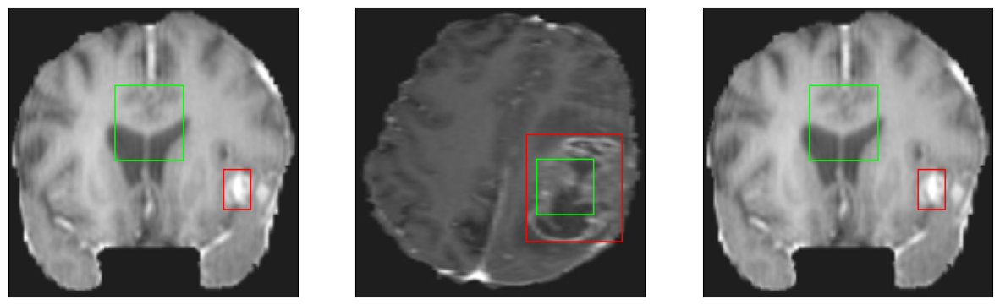

26/26 [==============================] - 3s 109ms/step - loss: 8.2950 - IoU: 0.4621 - val_loss: 12.9013 - val_IoU: 0.3598
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 7.9790 - IoU: 0.4915
Epoch 17: val_IoU improved from 0.35975 to 0.43729, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


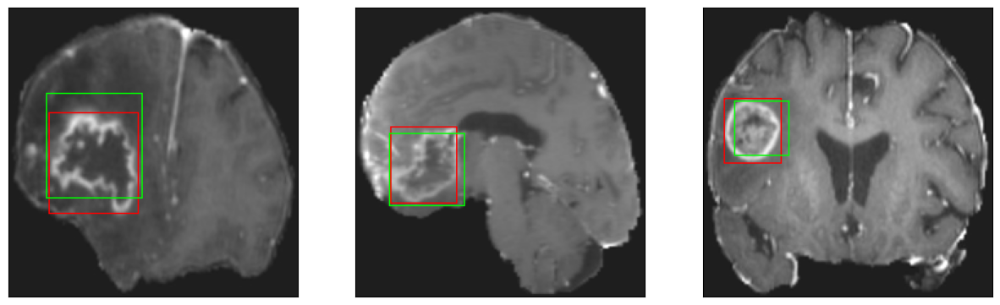

26/26 [==============================] - 3s 124ms/step - loss: 7.9790 - IoU: 0.4915 - val_loss: 10.5239 - val_IoU: 0.4373
Epoch 18/200
25/26 [===========================>..] - ETA: 0s - loss: 7.9191 - IoU: 0.4853
Epoch 18: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


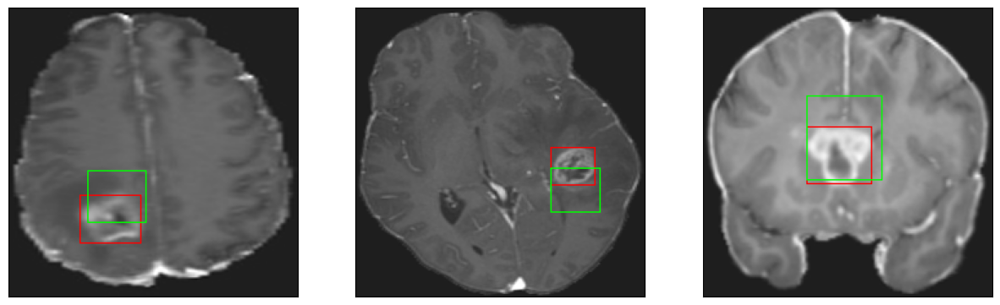

26/26 [==============================] - 3s 96ms/step - loss: 7.9303 - IoU: 0.4862 - val_loss: 13.0143 - val_IoU: 0.3365
Epoch 19/200
25/26 [===========================>..] - ETA: 0s - loss: 8.0013 - IoU: 0.4803
Epoch 19: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


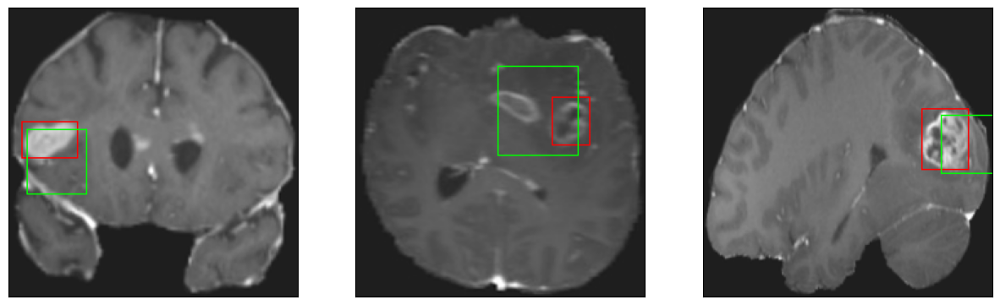

26/26 [==============================] - 2s 93ms/step - loss: 8.0019 - IoU: 0.4802 - val_loss: 12.1333 - val_IoU: 0.3722
Epoch 20/200
25/26 [===========================>..] - ETA: 0s - loss: 8.0974 - IoU: 0.4770
Epoch 20: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


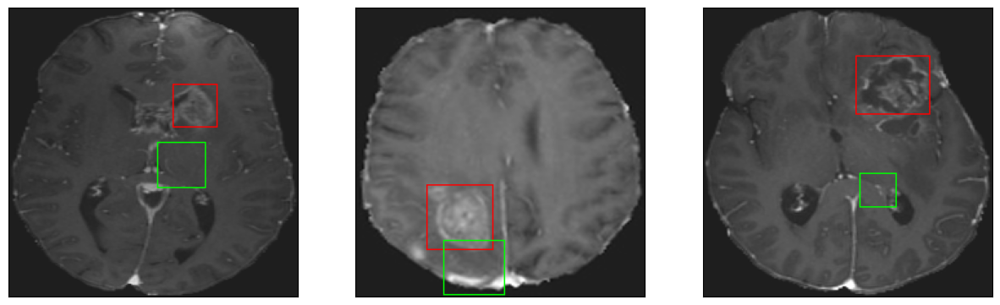

26/26 [==============================] - 3s 114ms/step - loss: 8.0390 - IoU: 0.4809 - val_loss: 11.8255 - val_IoU: 0.3769
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 7.6568 - IoU: 0.5024
Epoch 21: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


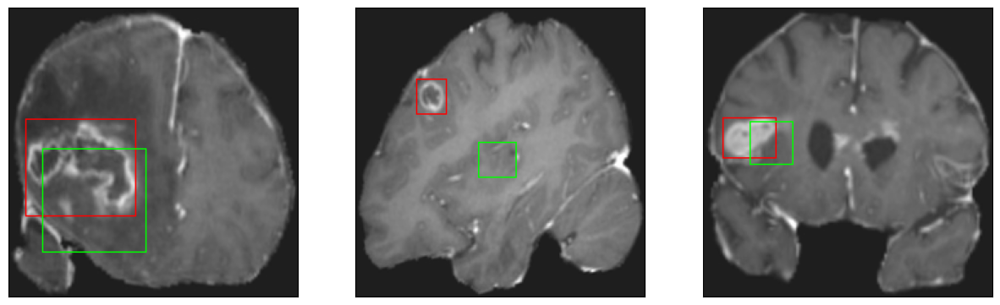

26/26 [==============================] - 3s 98ms/step - loss: 7.6568 - IoU: 0.5024 - val_loss: 11.7199 - val_IoU: 0.3557
Epoch 22/200
25/26 [===========================>..] - ETA: 0s - loss: 7.8584 - IoU: 0.4958
Epoch 22: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


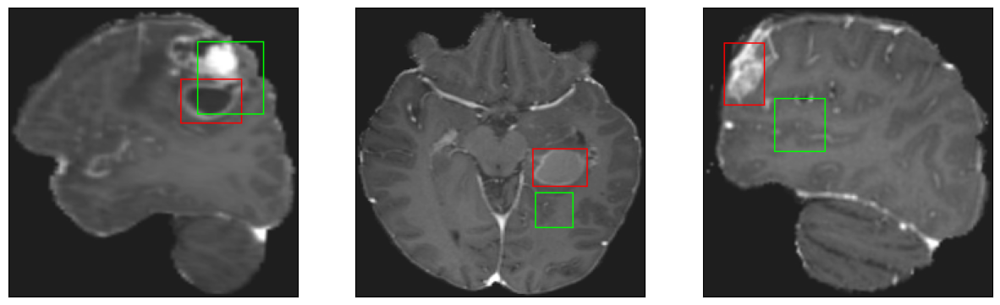

26/26 [==============================] - 3s 101ms/step - loss: 7.8544 - IoU: 0.4950 - val_loss: 16.8364 - val_IoU: 0.1824
Epoch 23/200
25/26 [===========================>..] - ETA: 0s - loss: 7.6307 - IoU: 0.5079
Epoch 23: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


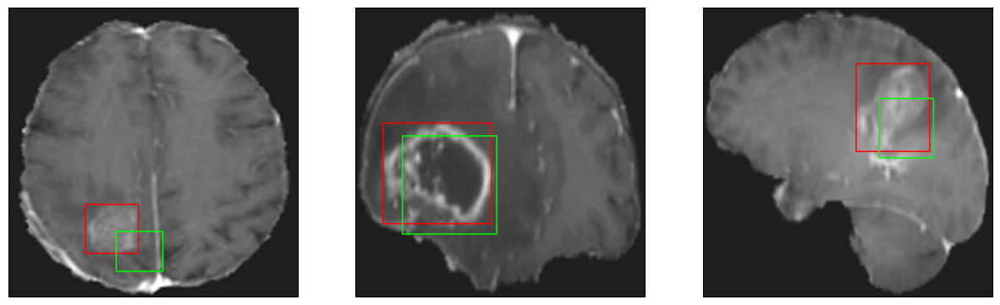

26/26 [==============================] - 3s 126ms/step - loss: 7.6663 - IoU: 0.5042 - val_loss: 11.8831 - val_IoU: 0.3218
Epoch 24/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4218 - IoU: 0.5125
Epoch 24: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


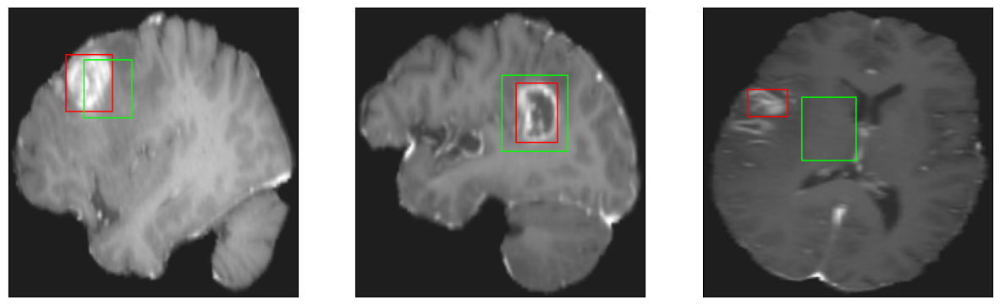

26/26 [==============================] - 3s 107ms/step - loss: 7.3711 - IoU: 0.5141 - val_loss: 12.2915 - val_IoU: 0.3706
Epoch 25/200
25/26 [===========================>..] - ETA: 0s - loss: 7.2354 - IoU: 0.5192
Epoch 25: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


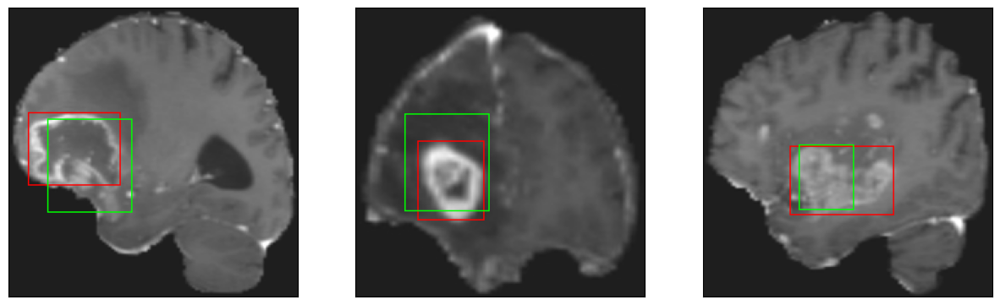

26/26 [==============================] - 2s 96ms/step - loss: 7.2045 - IoU: 0.5192 - val_loss: 10.8097 - val_IoU: 0.4243
Epoch 26/200
25/26 [===========================>..] - ETA: 0s - loss: 7.0147 - IoU: 0.5160
Epoch 26: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


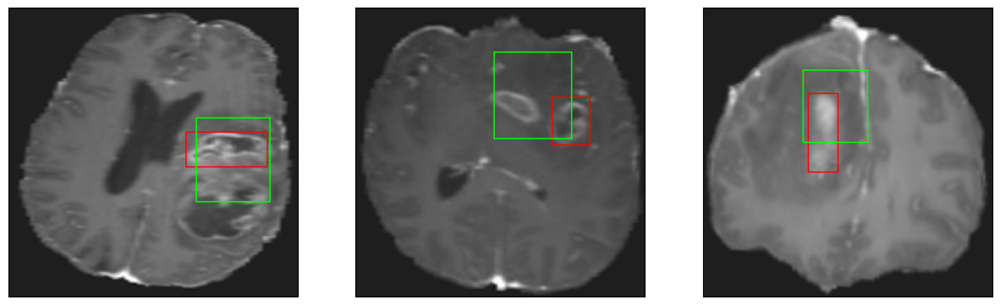

26/26 [==============================] - 3s 102ms/step - loss: 6.9731 - IoU: 0.5177 - val_loss: 11.3875 - val_IoU: 0.4249
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 6.9795 - IoU: 0.5353
Epoch 27: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


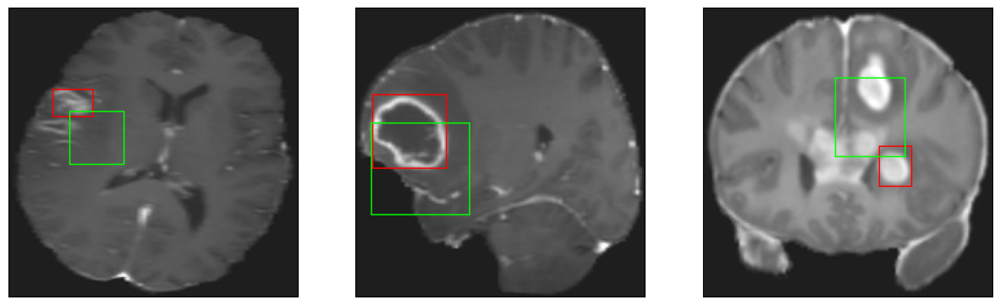

26/26 [==============================] - 3s 115ms/step - loss: 6.9795 - IoU: 0.5353 - val_loss: 15.6676 - val_IoU: 0.3040
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 7.4179 - IoU: 0.5018
Epoch 28: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


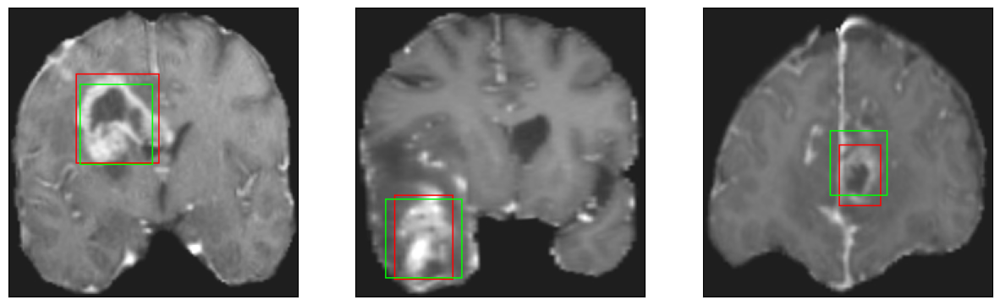

26/26 [==============================] - 3s 133ms/step - loss: 7.4179 - IoU: 0.5018 - val_loss: 11.2882 - val_IoU: 0.3548
Epoch 29/200
25/26 [===========================>..] - ETA: 0s - loss: 7.2342 - IoU: 0.5077
Epoch 29: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


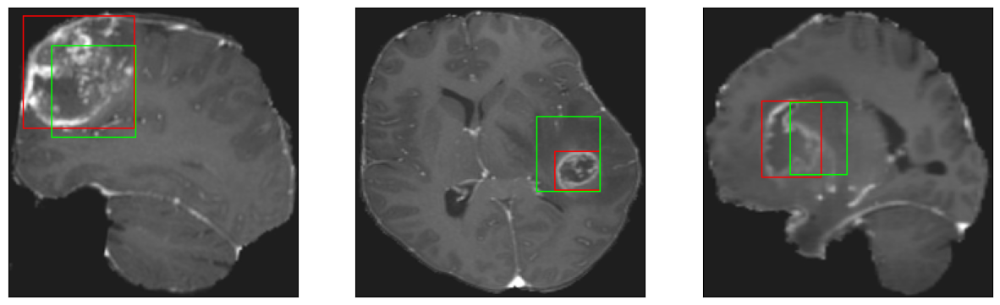

26/26 [==============================] - 3s 108ms/step - loss: 7.2066 - IoU: 0.5071 - val_loss: 16.3301 - val_IoU: 0.2691
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 7.3200 - IoU: 0.4981
Epoch 30: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


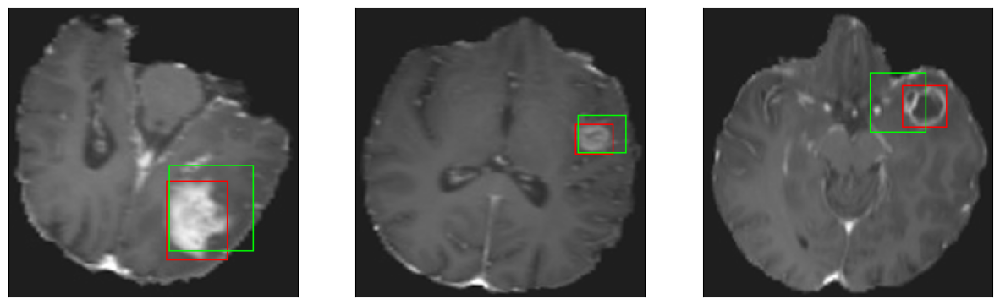

26/26 [==============================] - 3s 105ms/step - loss: 7.3200 - IoU: 0.4981 - val_loss: 11.0882 - val_IoU: 0.4329
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 6.7835 - IoU: 0.5382
Epoch 31: val_IoU did not improve from 0.43729
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


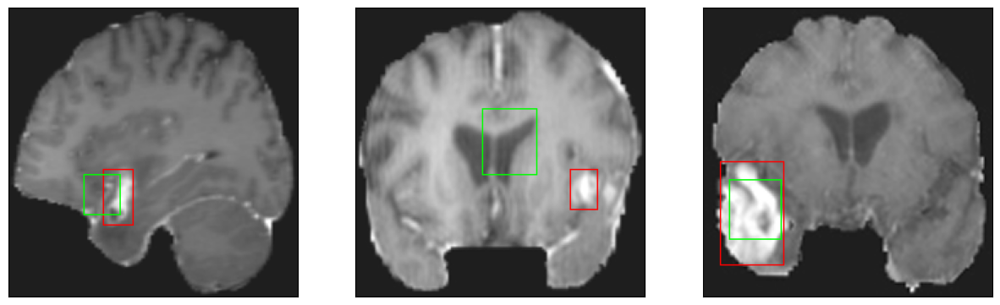

26/26 [==============================] - 3s 107ms/step - loss: 6.7835 - IoU: 0.5382 - val_loss: 11.4639 - val_IoU: 0.3673
Epoch 32/200
25/26 [===========================>..] - ETA: 0s - loss: 6.9131 - IoU: 0.5395
Epoch 32: val_IoU improved from 0.43729 to 0.48228, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


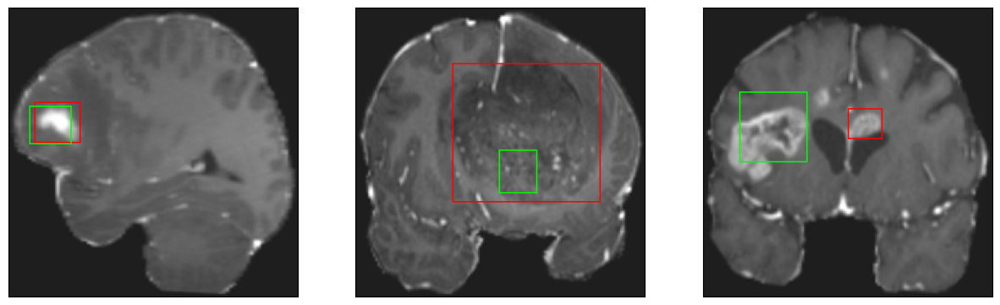

26/26 [==============================] - 3s 124ms/step - loss: 6.8596 - IoU: 0.5400 - val_loss: 9.5565 - val_IoU: 0.4823
Epoch 33/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5032 - IoU: 0.5452
Epoch 33: val_IoU did not improve from 0.48228
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


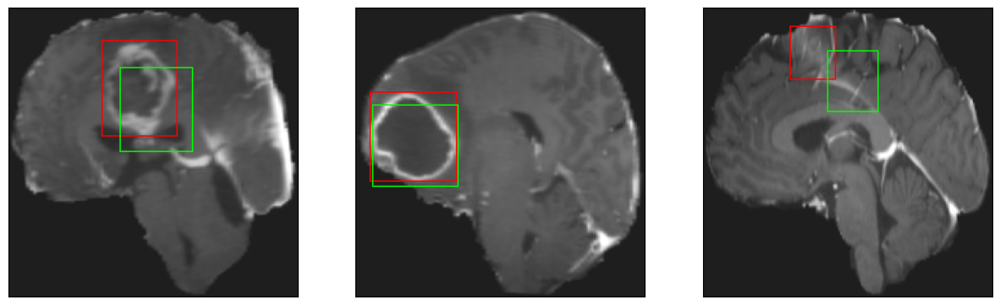

26/26 [==============================] - 3s 108ms/step - loss: 6.5095 - IoU: 0.5458 - val_loss: 11.2114 - val_IoU: 0.4220
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 6.4581 - IoU: 0.5547
Epoch 34: val_IoU did not improve from 0.48228
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


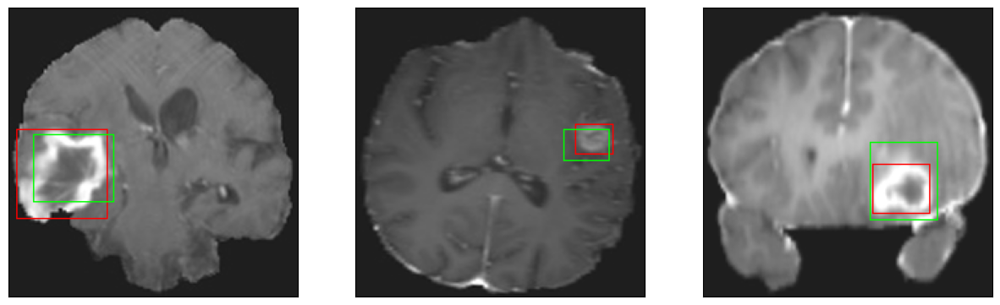

26/26 [==============================] - 3s 132ms/step - loss: 6.4581 - IoU: 0.5547 - val_loss: 11.0226 - val_IoU: 0.3648
Epoch 35/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4875 - IoU: 0.5494
Epoch 35: val_IoU did not improve from 0.48228
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


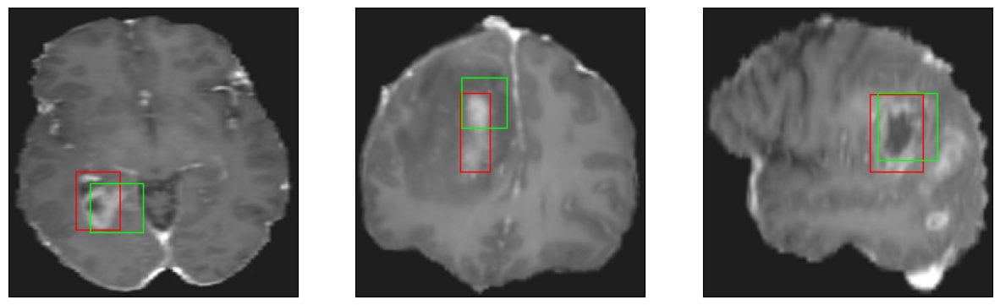

26/26 [==============================] - 3s 104ms/step - loss: 6.4898 - IoU: 0.5490 - val_loss: 10.0846 - val_IoU: 0.4358
Epoch 36/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5070 - IoU: 0.5488
Epoch 36: val_IoU did not improve from 0.48228
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


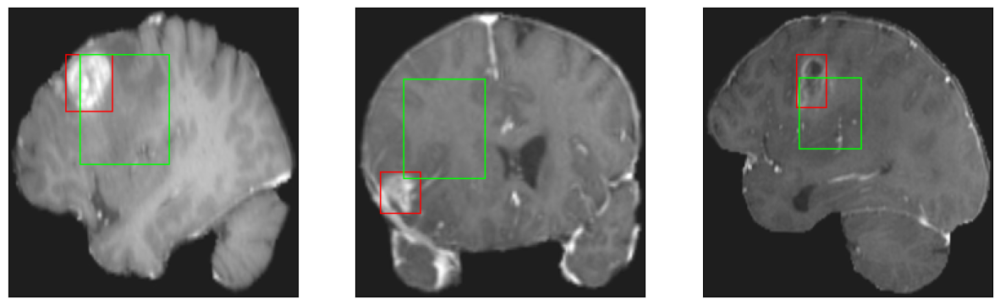

26/26 [==============================] - 3s 109ms/step - loss: 6.5296 - IoU: 0.5489 - val_loss: 23.5290 - val_IoU: 0.1741
Epoch 37/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5209 - IoU: 0.5382
Epoch 37: val_IoU did not improve from 0.48228
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4


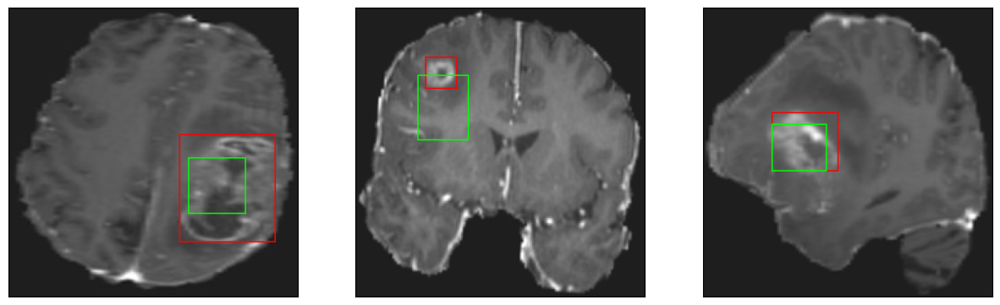

26/26 [==============================] - 3s 103ms/step - loss: 6.4925 - IoU: 0.5390 - val_loss: 12.3443 - val_IoU: 0.3562
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 6.3484 - IoU: 0.5555
Epoch 38: val_IoU improved from 0.48228 to 0.49556, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


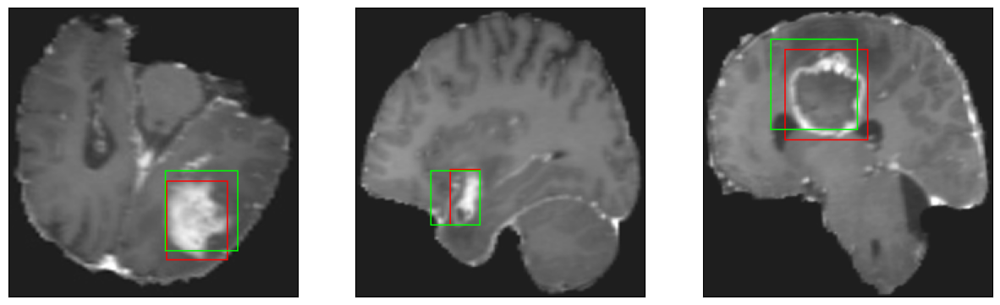

26/26 [==============================] - 4s 139ms/step - loss: 6.3484 - IoU: 0.5555 - val_loss: 10.1278 - val_IoU: 0.4956
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 6.3960 - IoU: 0.5386
Epoch 39: val_IoU improved from 0.49556 to 0.49655, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


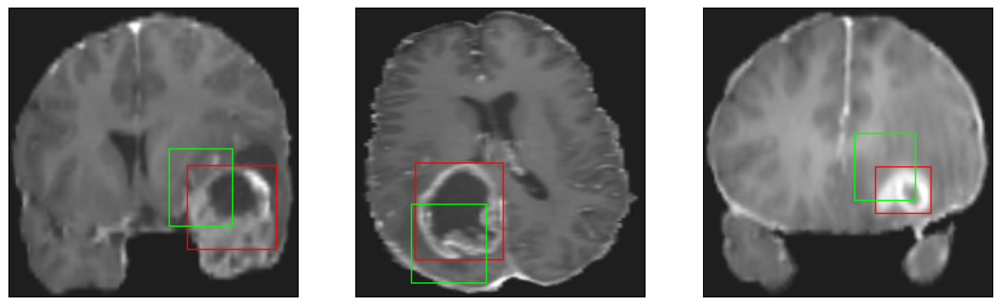

26/26 [==============================] - 3s 124ms/step - loss: 6.3960 - IoU: 0.5386 - val_loss: 9.2733 - val_IoU: 0.4966
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 6.4133 - IoU: 0.5483
Epoch 40: val_IoU did not improve from 0.49655
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


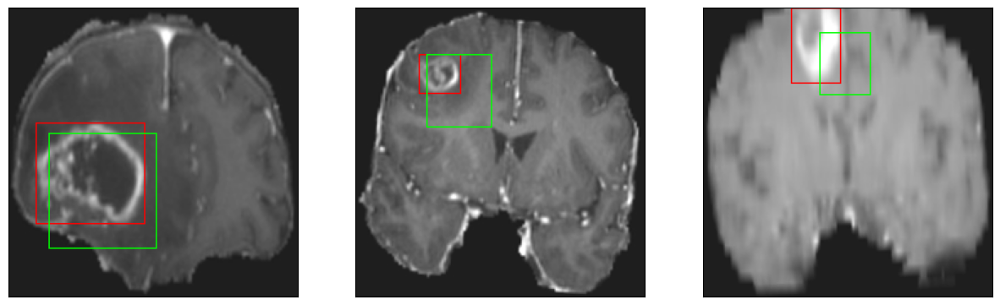

26/26 [==============================] - 3s 108ms/step - loss: 6.4133 - IoU: 0.5483 - val_loss: 11.5251 - val_IoU: 0.4224
Epoch 41/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3059 - IoU: 0.5534
Epoch 41: val_IoU did not improve from 0.49655
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


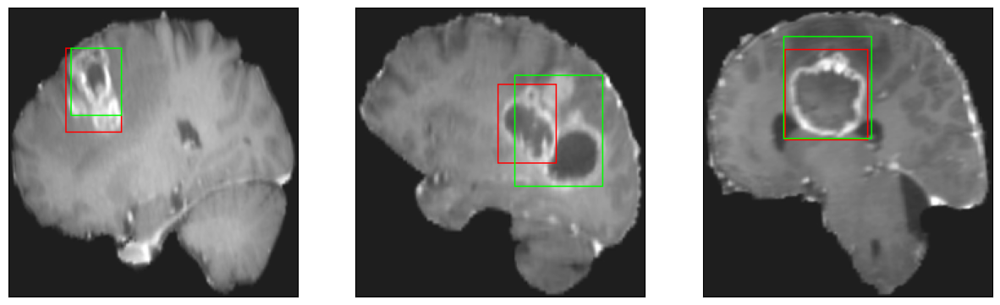

26/26 [==============================] - 4s 138ms/step - loss: 6.2493 - IoU: 0.5567 - val_loss: 10.2045 - val_IoU: 0.4865
Epoch 42/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9703 - IoU: 0.5685
Epoch 42: val_IoU did not improve from 0.49655
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


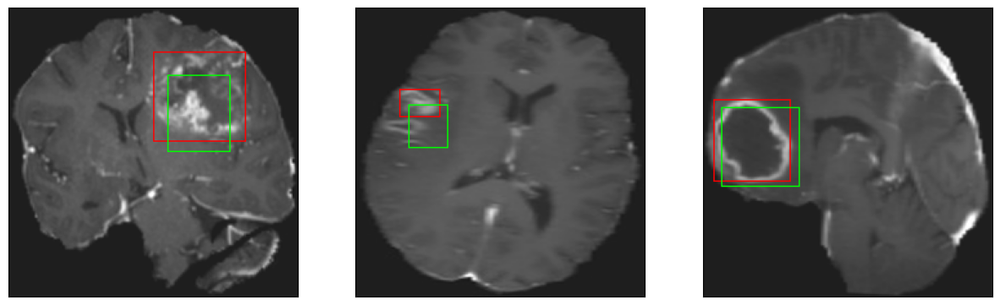

26/26 [==============================] - 3s 103ms/step - loss: 6.0088 - IoU: 0.5665 - val_loss: 11.0233 - val_IoU: 0.3771
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 6.3557 - IoU: 0.5400
Epoch 43: val_IoU did not improve from 0.49655
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


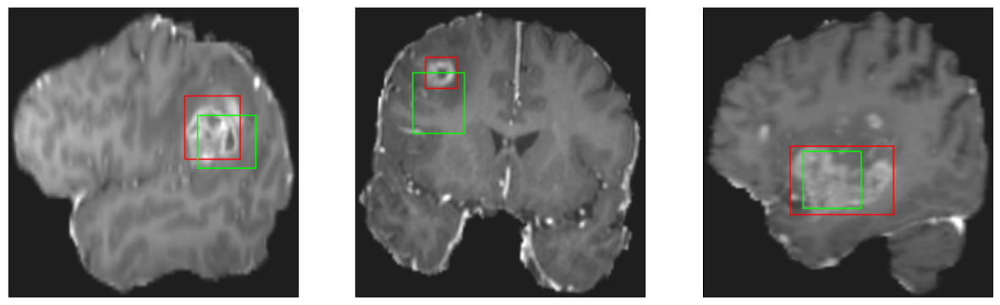

26/26 [==============================] - 3s 111ms/step - loss: 6.3557 - IoU: 0.5400 - val_loss: 10.7199 - val_IoU: 0.3882
Epoch 44/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8453 - IoU: 0.5733
Epoch 44: val_IoU improved from 0.49655 to 0.50976, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


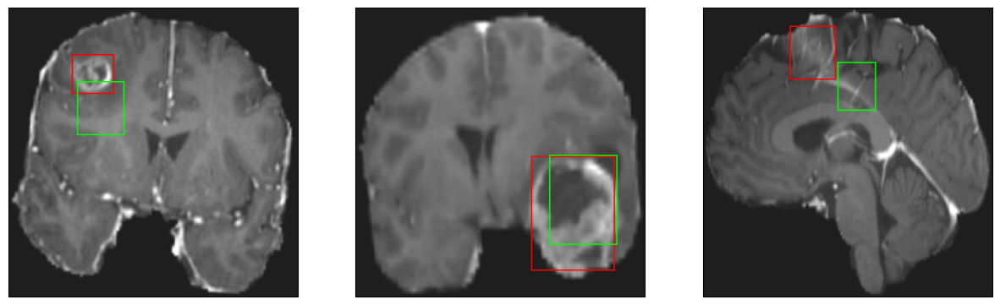

26/26 [==============================] - 4s 154ms/step - loss: 5.8426 - IoU: 0.5746 - val_loss: 8.8077 - val_IoU: 0.5098
Epoch 45/200
25/26 [===========================>..] - ETA: 0s - loss: 6.2385 - IoU: 0.5533
Epoch 45: val_IoU did not improve from 0.50976
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 13ms/step
4


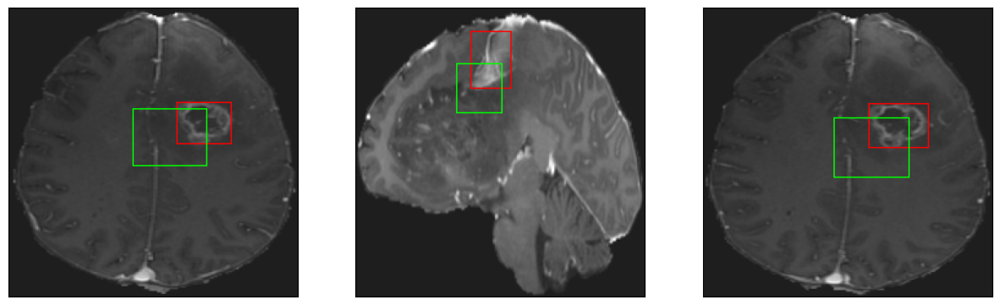

26/26 [==============================] - 3s 107ms/step - loss: 6.1703 - IoU: 0.5563 - val_loss: 9.4243 - val_IoU: 0.4755
Epoch 46/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1153 - IoU: 0.5677
Epoch 46: val_IoU did not improve from 0.50976
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


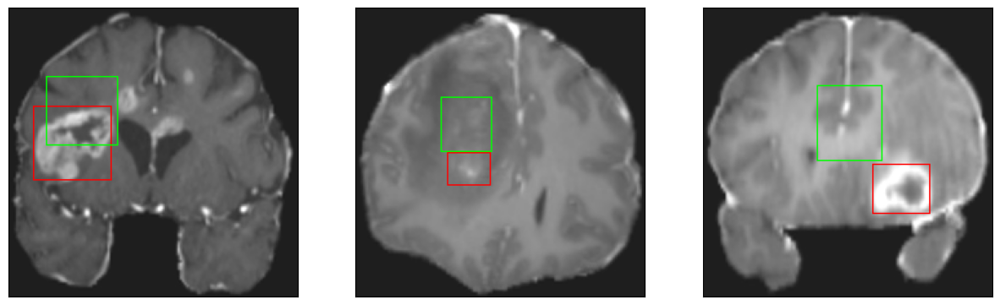

26/26 [==============================] - 3s 128ms/step - loss: 6.1176 - IoU: 0.5675 - val_loss: 16.4777 - val_IoU: 0.2039
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1172 - IoU: 0.5620
Epoch 47: val_IoU did not improve from 0.50976
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


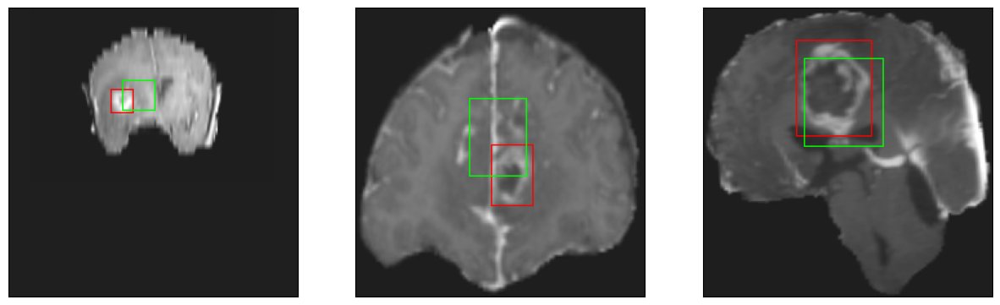

26/26 [==============================] - 3s 118ms/step - loss: 6.1497 - IoU: 0.5606 - val_loss: 10.7519 - val_IoU: 0.3896
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 5.8185 - IoU: 0.5658
Epoch 48: val_IoU did not improve from 0.50976
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


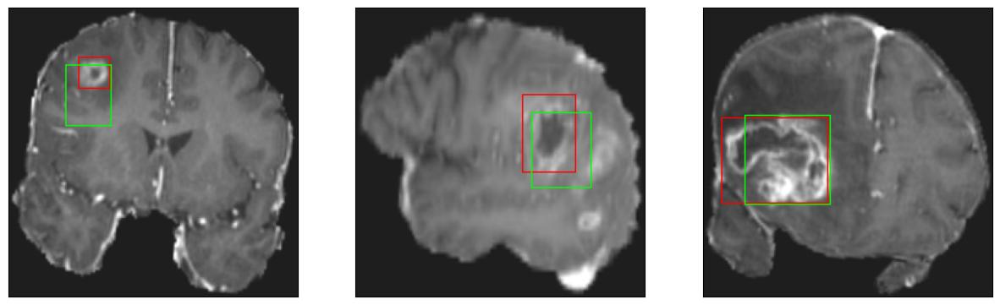

26/26 [==============================] - 3s 129ms/step - loss: 5.8185 - IoU: 0.5658 - val_loss: 8.9283 - val_IoU: 0.5053
Epoch 49/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3005 - IoU: 0.5655
Epoch 49: val_IoU improved from 0.50976 to 0.51516, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


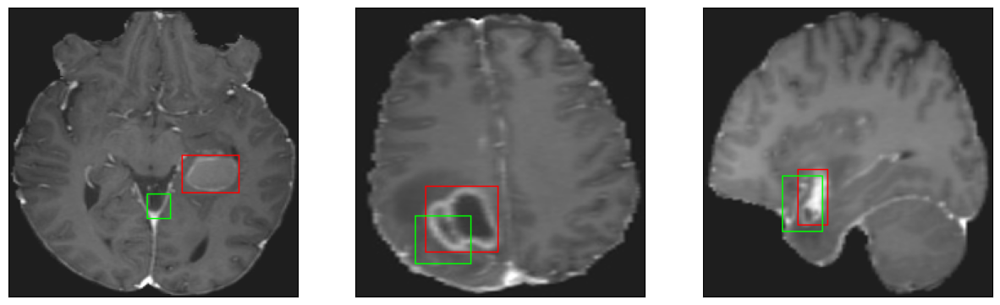

26/26 [==============================] - 4s 138ms/step - loss: 6.2216 - IoU: 0.5687 - val_loss: 8.7896 - val_IoU: 0.5152
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 5.9425 - IoU: 0.5622
Epoch 50: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


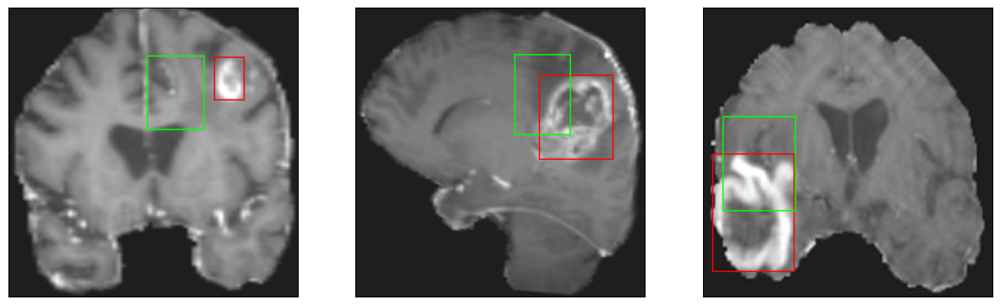

26/26 [==============================] - 3s 119ms/step - loss: 5.9425 - IoU: 0.5622 - val_loss: 13.9072 - val_IoU: 0.3037
Epoch 51/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0424 - IoU: 0.5711
Epoch 51: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


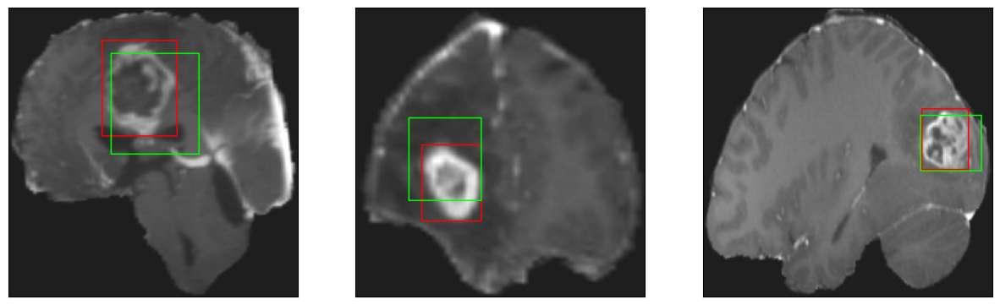

26/26 [==============================] - 3s 116ms/step - loss: 6.0617 - IoU: 0.5708 - val_loss: 9.4923 - val_IoU: 0.5092
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 5.7005 - IoU: 0.5848
Epoch 52: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


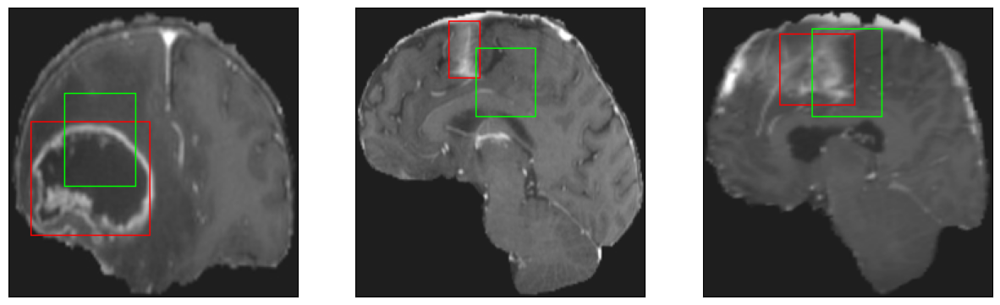

26/26 [==============================] - 3s 111ms/step - loss: 5.7005 - IoU: 0.5848 - val_loss: 16.4587 - val_IoU: 0.2474
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 5.6323 - IoU: 0.5914
Epoch 53: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


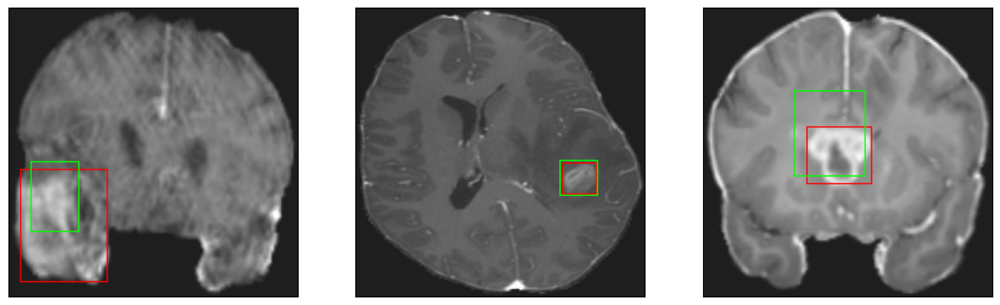

26/26 [==============================] - 3s 111ms/step - loss: 5.6323 - IoU: 0.5914 - val_loss: 9.3013 - val_IoU: 0.4756
Epoch 54/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1205 - IoU: 0.5492
Epoch 54: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


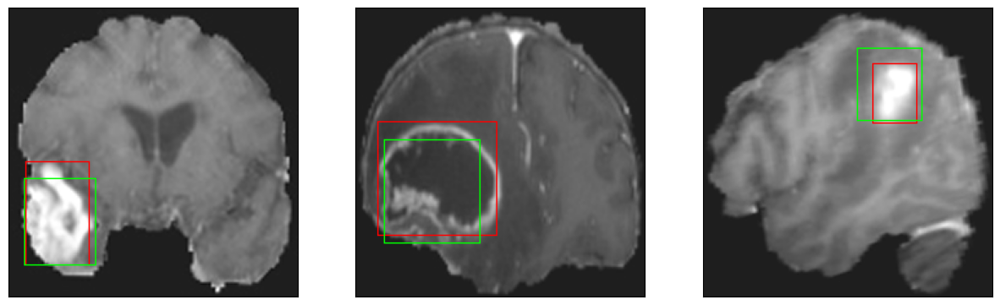

26/26 [==============================] - 3s 99ms/step - loss: 6.0879 - IoU: 0.5503 - val_loss: 9.6447 - val_IoU: 0.4925
Epoch 55/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6257 - IoU: 0.5817
Epoch 55: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


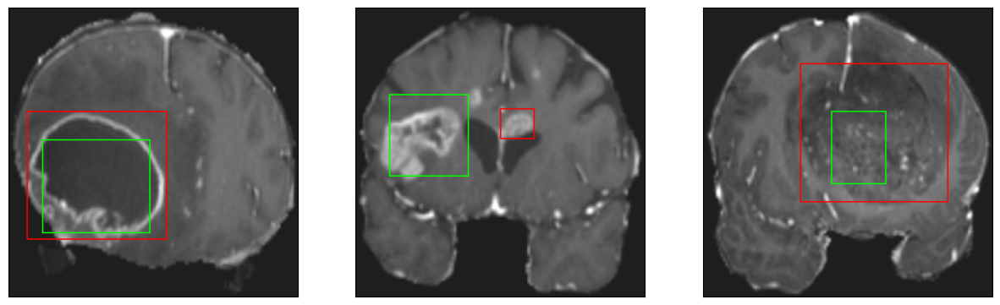

26/26 [==============================] - 3s 127ms/step - loss: 5.5901 - IoU: 0.5845 - val_loss: 10.3049 - val_IoU: 0.4839
Epoch 56/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8031 - IoU: 0.5776
Epoch 56: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


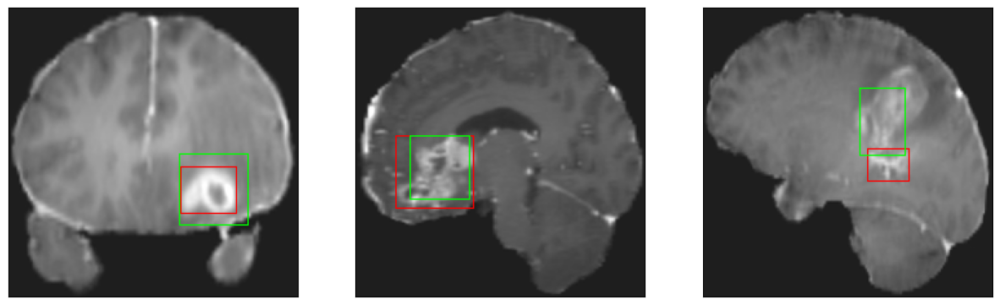

26/26 [==============================] - 3s 124ms/step - loss: 5.8354 - IoU: 0.5764 - val_loss: 9.8748 - val_IoU: 0.4825
Epoch 57/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4751 - IoU: 0.5938
Epoch 57: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


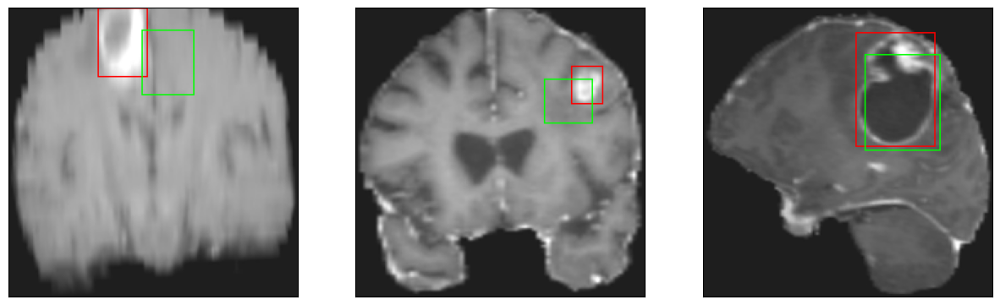

26/26 [==============================] - 3s 109ms/step - loss: 5.5051 - IoU: 0.5936 - val_loss: 11.9954 - val_IoU: 0.3561
Epoch 58/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5187 - IoU: 0.5888
Epoch 58: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


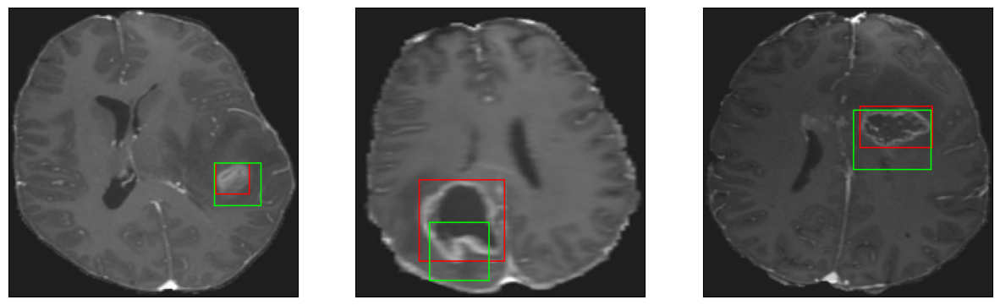

26/26 [==============================] - 3s 106ms/step - loss: 5.5144 - IoU: 0.5883 - val_loss: 10.6551 - val_IoU: 0.3729
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 5.3824 - IoU: 0.5986
Epoch 59: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


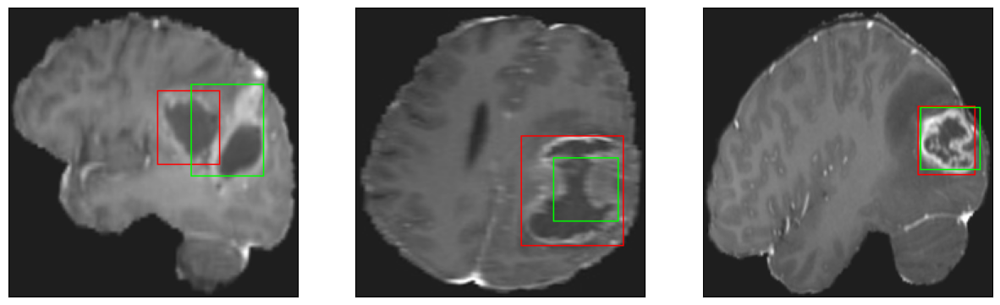

26/26 [==============================] - 3s 134ms/step - loss: 5.3824 - IoU: 0.5986 - val_loss: 8.9526 - val_IoU: 0.5141
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 5.2827 - IoU: 0.6019
Epoch 60: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


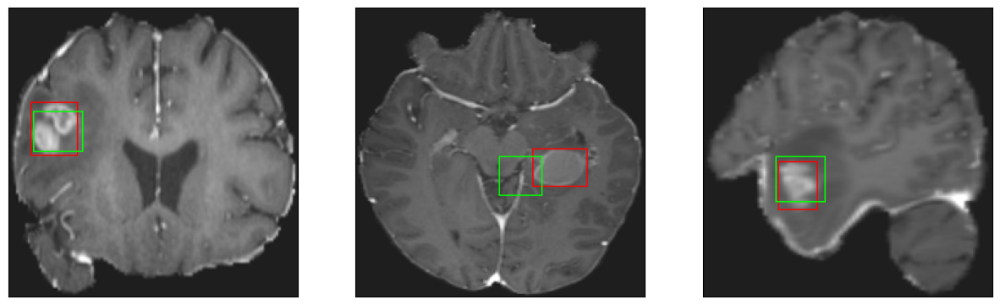

26/26 [==============================] - 3s 112ms/step - loss: 5.2827 - IoU: 0.6019 - val_loss: 8.9423 - val_IoU: 0.4907
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 5.7468 - IoU: 0.5750
Epoch 61: val_IoU did not improve from 0.51516
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


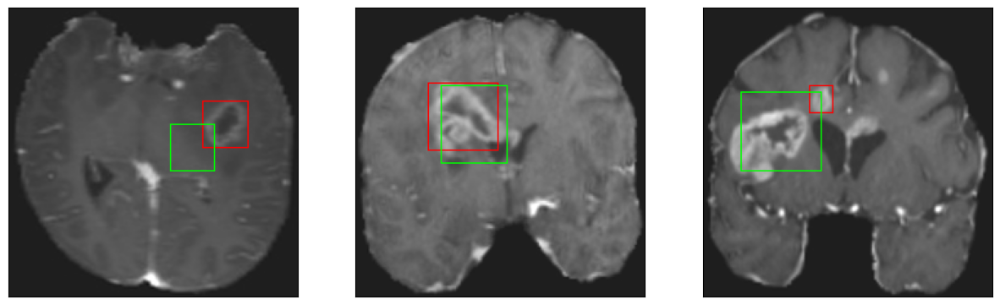

26/26 [==============================] - 3s 126ms/step - loss: 5.7468 - IoU: 0.5750 - val_loss: 10.3787 - val_IoU: 0.4622
Epoch 62/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6611 - IoU: 0.5905
Epoch 62: val_IoU improved from 0.51516 to 0.51739, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


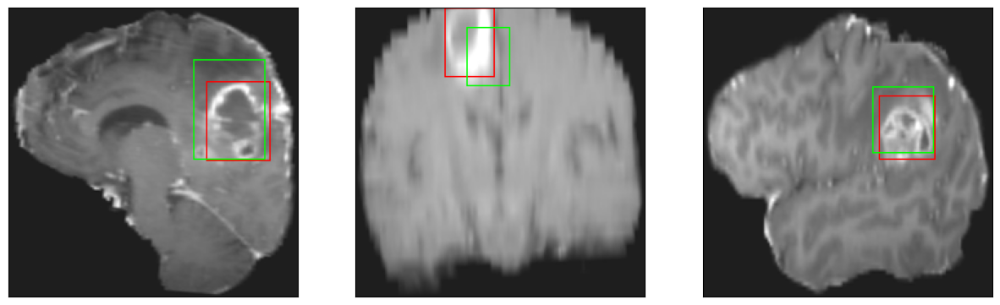

26/26 [==============================] - 3s 132ms/step - loss: 5.7058 - IoU: 0.5889 - val_loss: 8.9823 - val_IoU: 0.5174
Epoch 63/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3697 - IoU: 0.5901
Epoch 63: val_IoU improved from 0.51739 to 0.52978, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


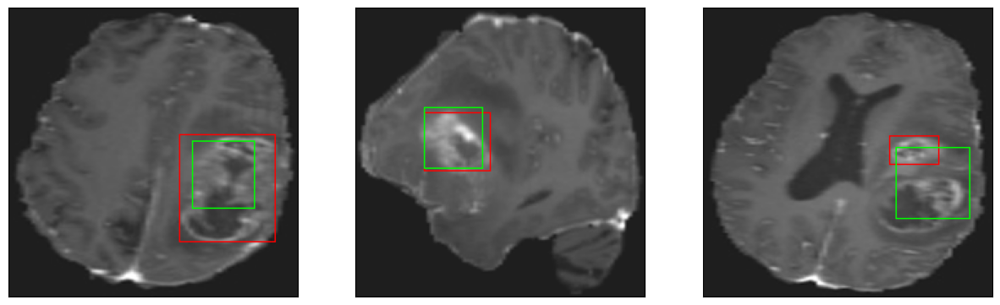

26/26 [==============================] - 3s 118ms/step - loss: 5.3558 - IoU: 0.5921 - val_loss: 9.0847 - val_IoU: 0.5298
Epoch 64/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0682 - IoU: 0.6187
Epoch 64: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


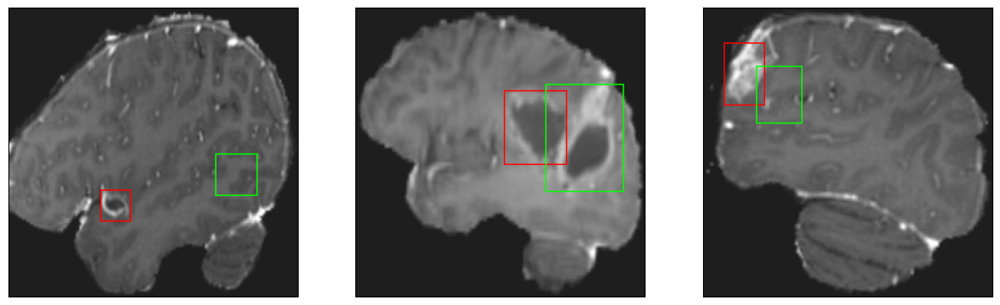

26/26 [==============================] - 3s 103ms/step - loss: 5.0964 - IoU: 0.6178 - val_loss: 10.1315 - val_IoU: 0.4443
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9921 - IoU: 0.6116
Epoch 65: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


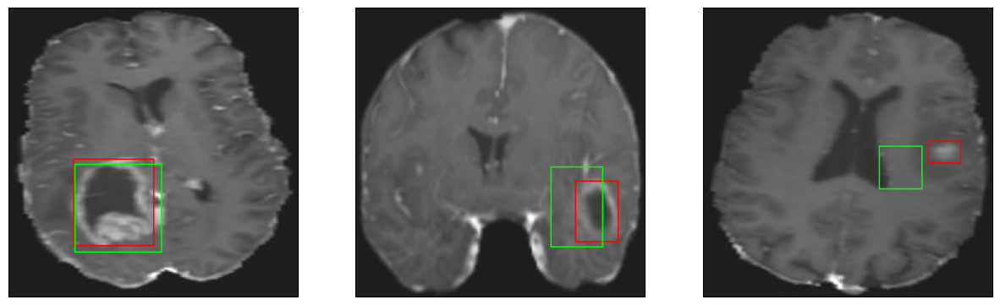

26/26 [==============================] - 3s 106ms/step - loss: 4.9992 - IoU: 0.6118 - val_loss: 10.2132 - val_IoU: 0.4647
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 5.2211 - IoU: 0.6053
Epoch 66: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4


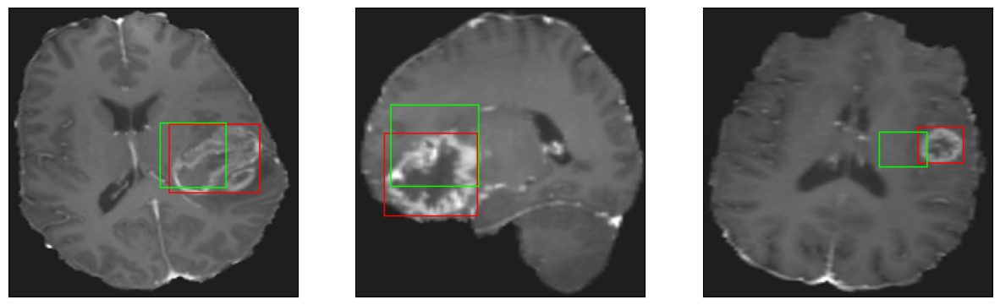

26/26 [==============================] - 3s 131ms/step - loss: 5.2211 - IoU: 0.6053 - val_loss: 18.8343 - val_IoU: 0.2099
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 5.5301 - IoU: 0.5904
Epoch 67: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


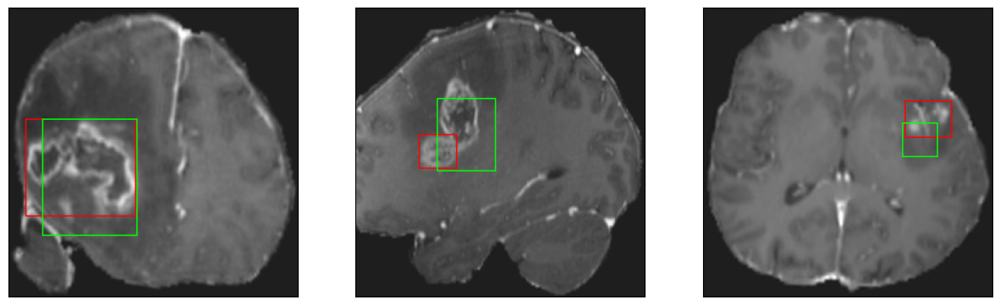

26/26 [==============================] - 3s 102ms/step - loss: 5.5301 - IoU: 0.5904 - val_loss: 9.0788 - val_IoU: 0.4967
Epoch 68/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2299 - IoU: 0.6081
Epoch 68: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


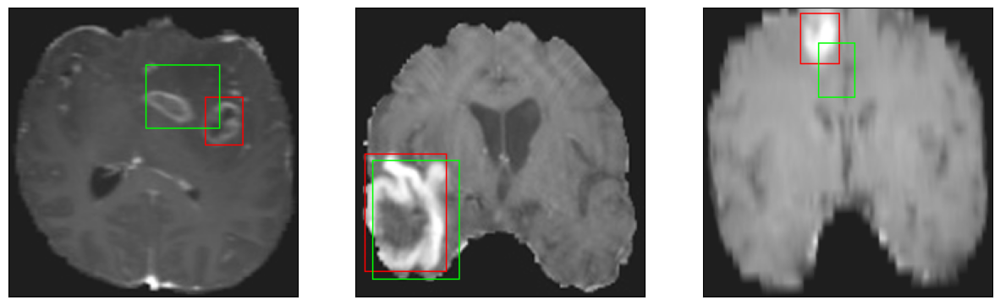

26/26 [==============================] - 3s 106ms/step - loss: 5.2267 - IoU: 0.6093 - val_loss: 8.8249 - val_IoU: 0.5224
Epoch 69/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1813 - IoU: 0.6048
Epoch 69: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


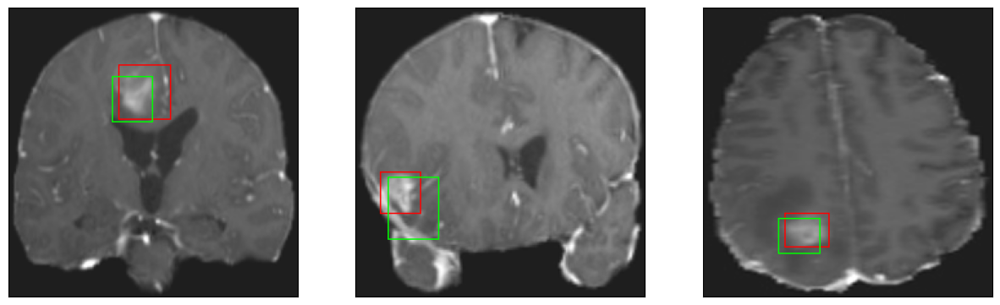

26/26 [==============================] - 3s 110ms/step - loss: 5.1641 - IoU: 0.6040 - val_loss: 8.6359 - val_IoU: 0.4992
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 5.0106 - IoU: 0.6102
Epoch 70: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


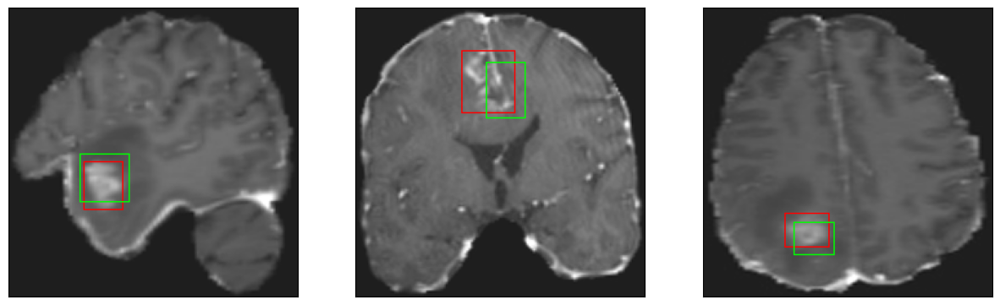

26/26 [==============================] - 3s 129ms/step - loss: 5.0106 - IoU: 0.6102 - val_loss: 9.4140 - val_IoU: 0.4615
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0538 - IoU: 0.6121
Epoch 71: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


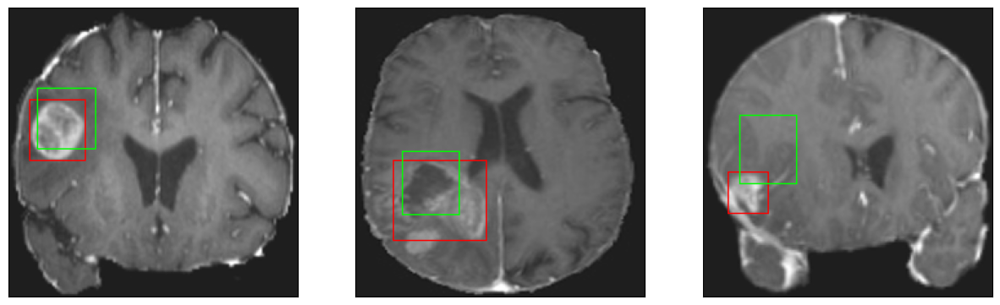

26/26 [==============================] - 3s 112ms/step - loss: 5.0340 - IoU: 0.6132 - val_loss: 13.3049 - val_IoU: 0.3060
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 5.2882 - IoU: 0.5965
Epoch 72: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


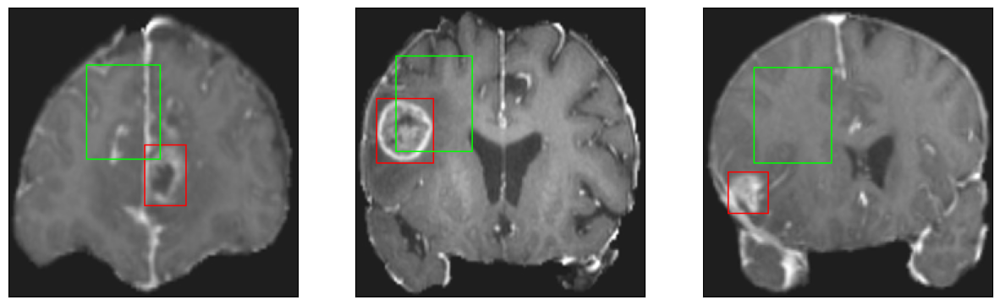

26/26 [==============================] - 3s 106ms/step - loss: 5.2882 - IoU: 0.5965 - val_loss: 22.1637 - val_IoU: 0.1931
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 5.2410 - IoU: 0.6041
Epoch 73: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


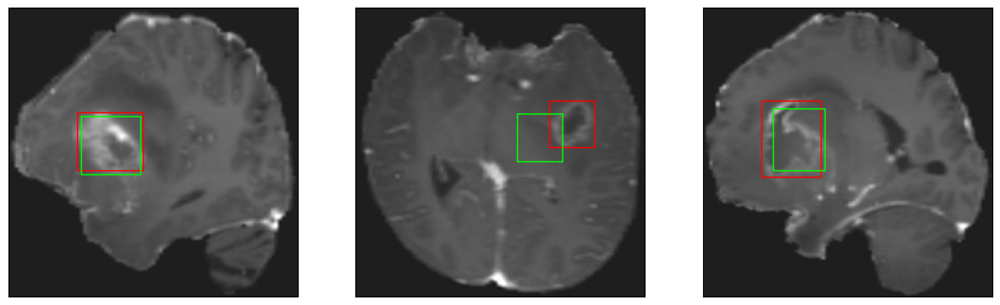

26/26 [==============================] - 3s 102ms/step - loss: 5.2410 - IoU: 0.6041 - val_loss: 9.0809 - val_IoU: 0.5076
Epoch 74/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7396 - IoU: 0.6331
Epoch 74: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


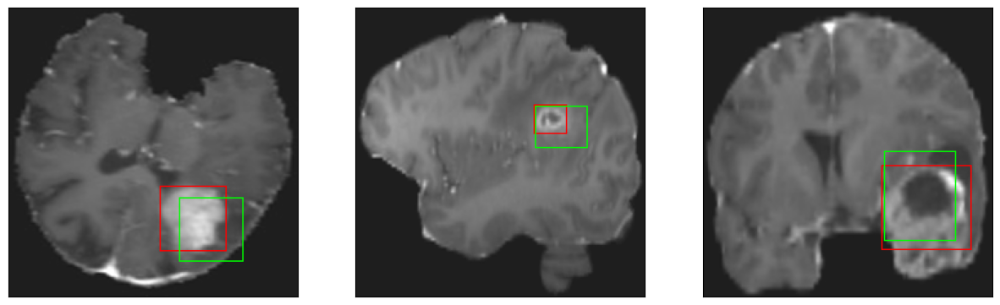

26/26 [==============================] - 3s 114ms/step - loss: 4.7255 - IoU: 0.6333 - val_loss: 9.8254 - val_IoU: 0.4564
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 5.2884 - IoU: 0.6000
Epoch 75: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 14ms/step
4


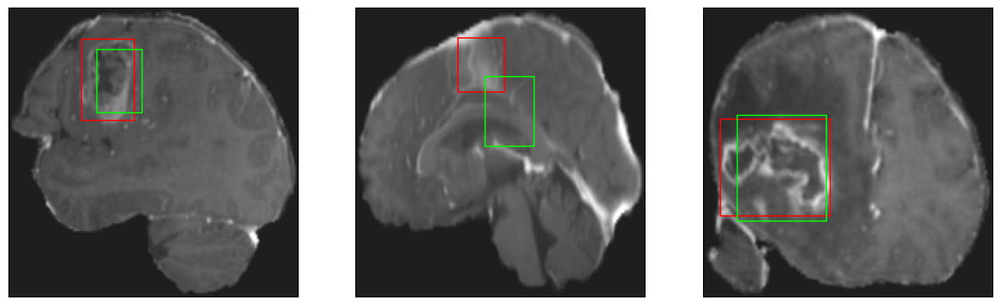

26/26 [==============================] - 3s 126ms/step - loss: 5.2884 - IoU: 0.6000 - val_loss: 8.9136 - val_IoU: 0.5220
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3901 - IoU: 0.5979
Epoch 76: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


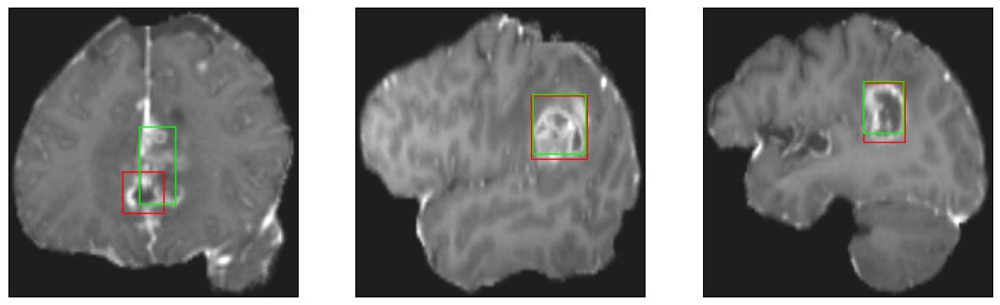

26/26 [==============================] - 3s 117ms/step - loss: 5.4727 - IoU: 0.5949 - val_loss: 9.5871 - val_IoU: 0.4830
Epoch 77/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6230 - IoU: 0.5895
Epoch 77: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


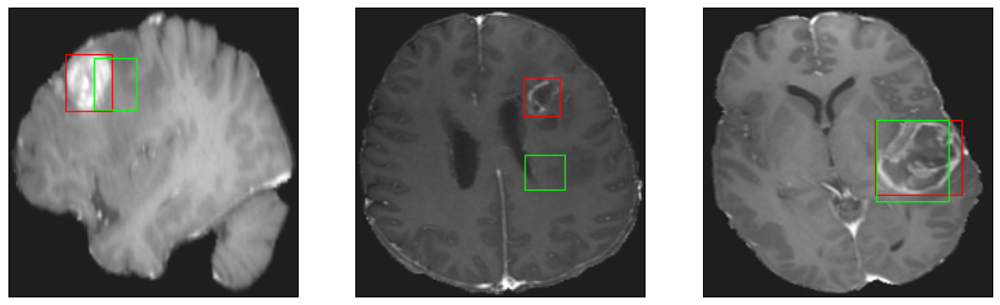

26/26 [==============================] - 3s 99ms/step - loss: 5.6107 - IoU: 0.5896 - val_loss: 9.6965 - val_IoU: 0.4634
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2909 - IoU: 0.5999
Epoch 78: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


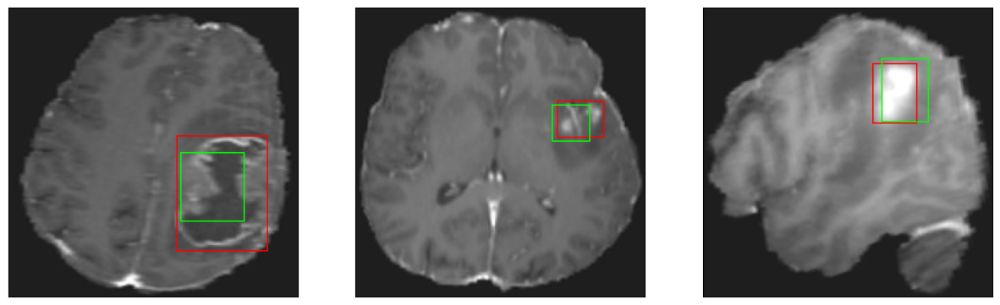

26/26 [==============================] - 3s 103ms/step - loss: 5.3061 - IoU: 0.5999 - val_loss: 8.8386 - val_IoU: 0.5237
Epoch 79/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9923 - IoU: 0.6098
Epoch 79: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


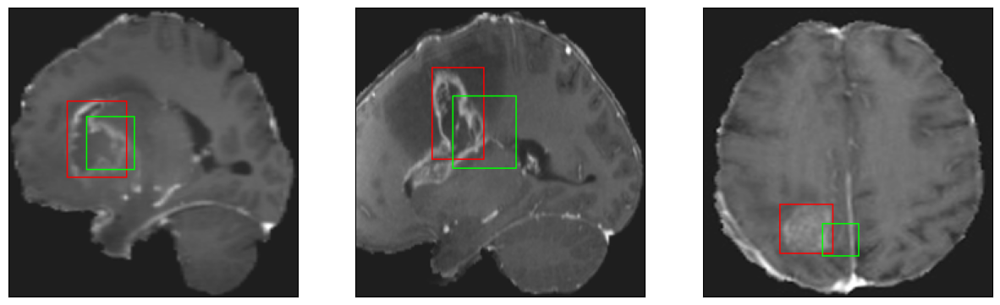

26/26 [==============================] - 3s 129ms/step - loss: 4.9832 - IoU: 0.6114 - val_loss: 9.1255 - val_IoU: 0.4949
Epoch 80/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0984 - IoU: 0.5966
Epoch 80: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


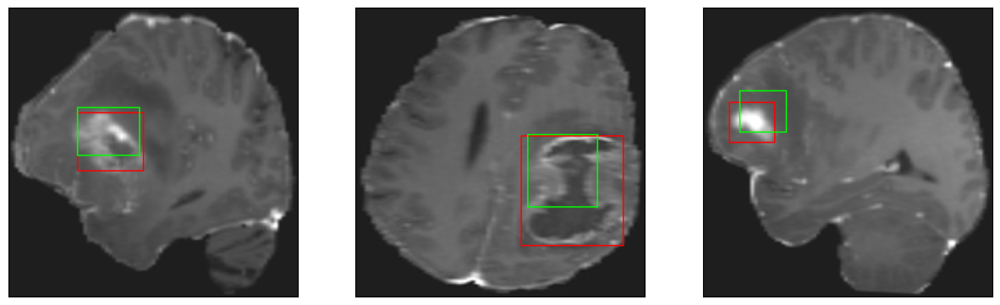

26/26 [==============================] - 3s 101ms/step - loss: 5.0610 - IoU: 0.5997 - val_loss: 9.4323 - val_IoU: 0.4858
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 4.8727 - IoU: 0.6196
Epoch 81: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


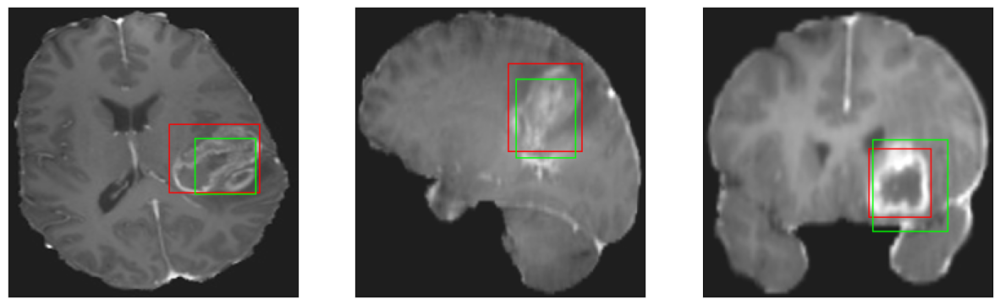

26/26 [==============================] - 3s 104ms/step - loss: 4.8727 - IoU: 0.6196 - val_loss: 9.2963 - val_IoU: 0.4888
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 4.8163 - IoU: 0.6279
Epoch 82: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


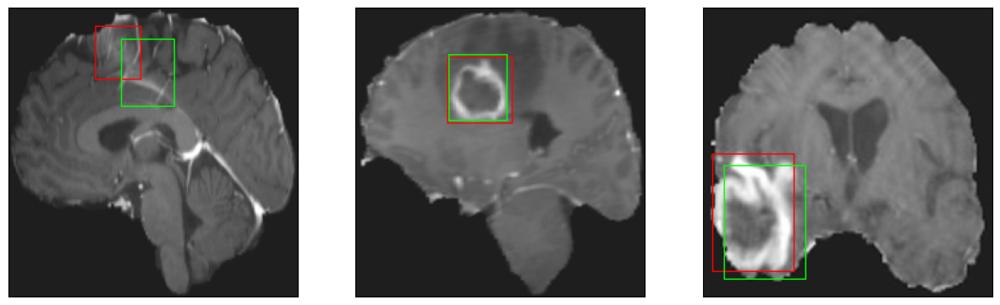

26/26 [==============================] - 4s 135ms/step - loss: 4.8163 - IoU: 0.6279 - val_loss: 9.7755 - val_IoU: 0.5046
Epoch 83/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8335 - IoU: 0.6260
Epoch 83: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


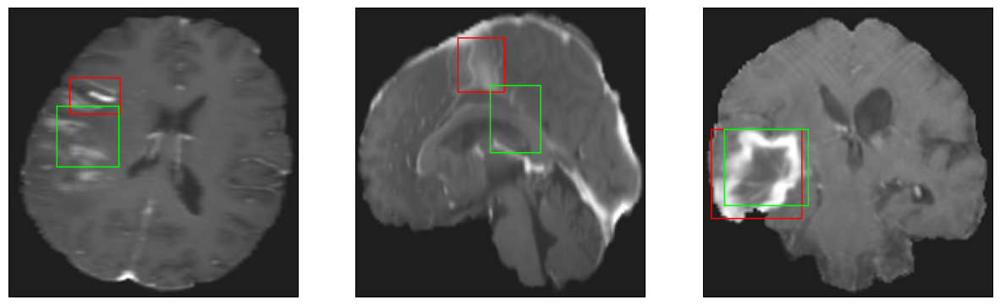

26/26 [==============================] - 3s 118ms/step - loss: 4.7877 - IoU: 0.6283 - val_loss: 8.7463 - val_IoU: 0.5284
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9795 - IoU: 0.6250
Epoch 84: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


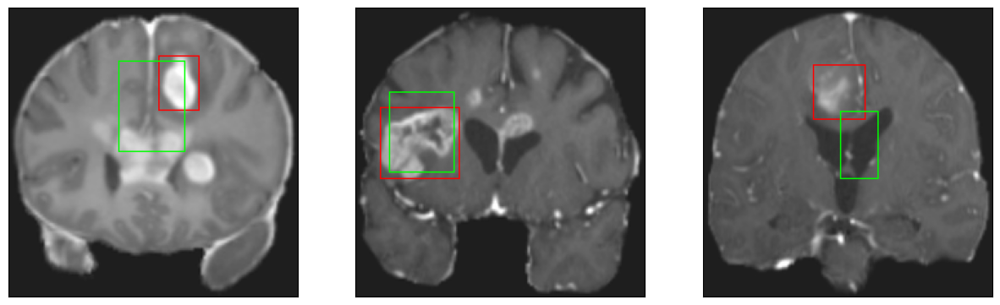

26/26 [==============================] - 3s 97ms/step - loss: 5.0063 - IoU: 0.6239 - val_loss: 10.9492 - val_IoU: 0.4586
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0960 - IoU: 0.6092
Epoch 85: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


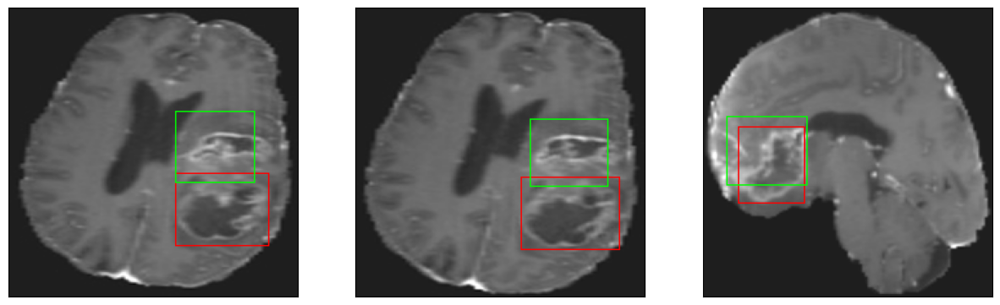

26/26 [==============================] - 3s 109ms/step - loss: 5.0965 - IoU: 0.6102 - val_loss: 9.4094 - val_IoU: 0.4611
Epoch 86/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0487 - IoU: 0.6051
Epoch 86: val_IoU did not improve from 0.52978
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


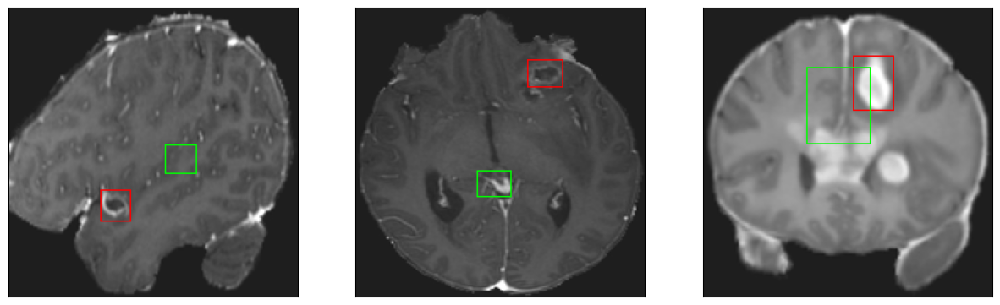

26/26 [==============================] - 3s 105ms/step - loss: 5.0240 - IoU: 0.6067 - val_loss: 11.0188 - val_IoU: 0.3946
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 4.8276 - IoU: 0.6253
Epoch 87: val_IoU improved from 0.52978 to 0.53978, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


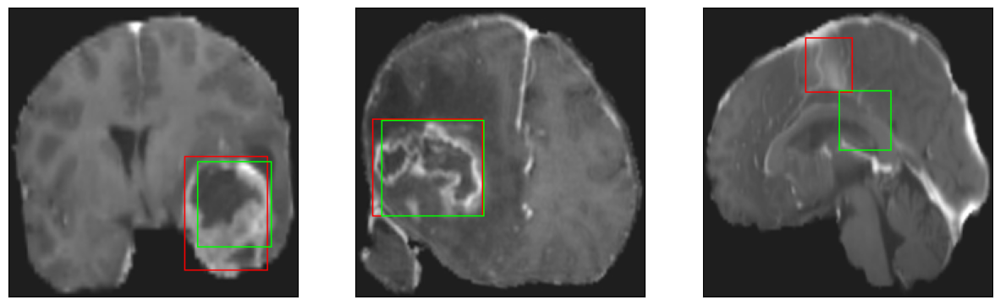

26/26 [==============================] - 4s 152ms/step - loss: 4.8276 - IoU: 0.6253 - val_loss: 8.6623 - val_IoU: 0.5398
Epoch 88/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0656 - IoU: 0.6287
Epoch 88: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


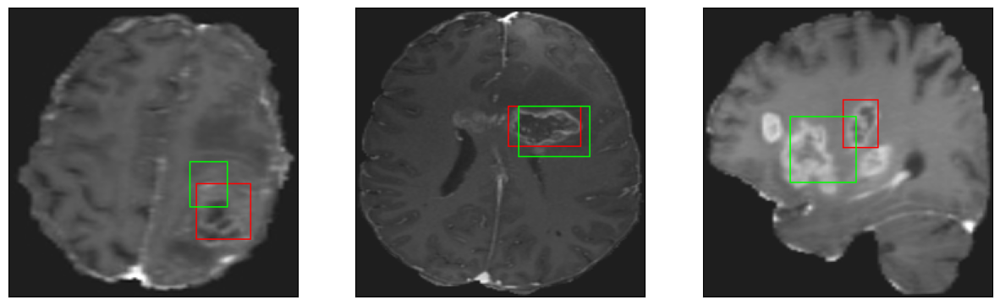

26/26 [==============================] - 3s 105ms/step - loss: 5.0283 - IoU: 0.6300 - val_loss: 9.1428 - val_IoU: 0.4921
Epoch 89/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0573 - IoU: 0.6065
Epoch 89: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


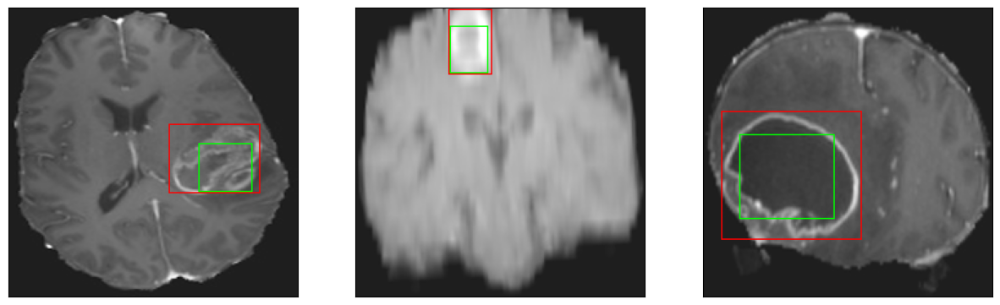

26/26 [==============================] - 3s 106ms/step - loss: 5.0357 - IoU: 0.6058 - val_loss: 9.0056 - val_IoU: 0.4889
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 5.0013 - IoU: 0.6128
Epoch 90: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


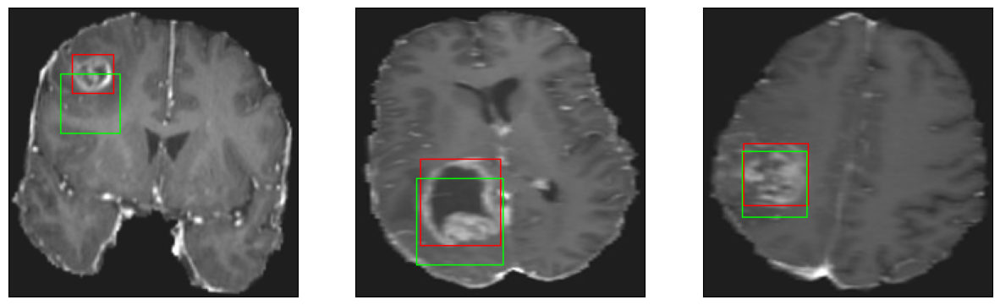

26/26 [==============================] - 3s 100ms/step - loss: 5.0013 - IoU: 0.6128 - val_loss: 8.6285 - val_IoU: 0.5237
Epoch 91/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7345 - IoU: 0.6276
Epoch 91: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


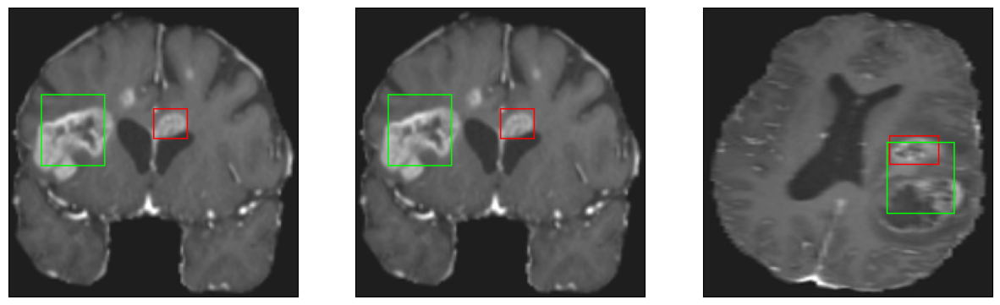

26/26 [==============================] - 3s 120ms/step - loss: 4.7924 - IoU: 0.6255 - val_loss: 9.0575 - val_IoU: 0.4982
Epoch 92/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0419 - IoU: 0.6164
Epoch 92: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


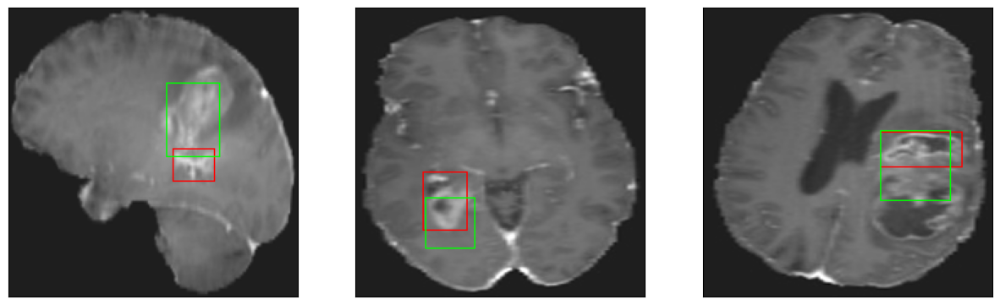

26/26 [==============================] - 3s 116ms/step - loss: 5.0084 - IoU: 0.6175 - val_loss: 8.5213 - val_IoU: 0.5092
Epoch 93/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0383 - IoU: 0.6093
Epoch 93: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


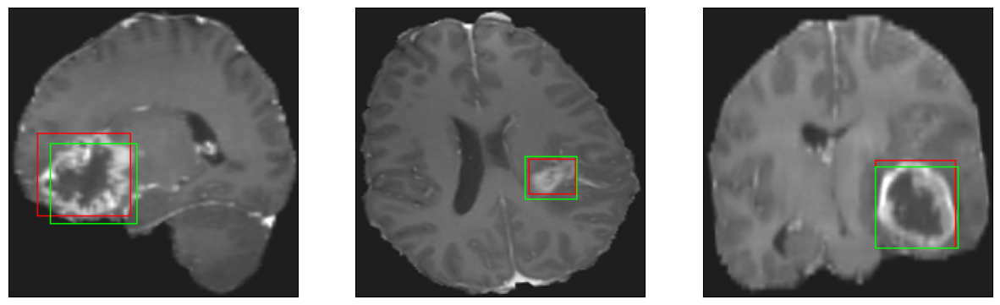

26/26 [==============================] - 3s 106ms/step - loss: 5.0741 - IoU: 0.6088 - val_loss: 8.8707 - val_IoU: 0.5384
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 4.9902 - IoU: 0.6167
Epoch 94: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


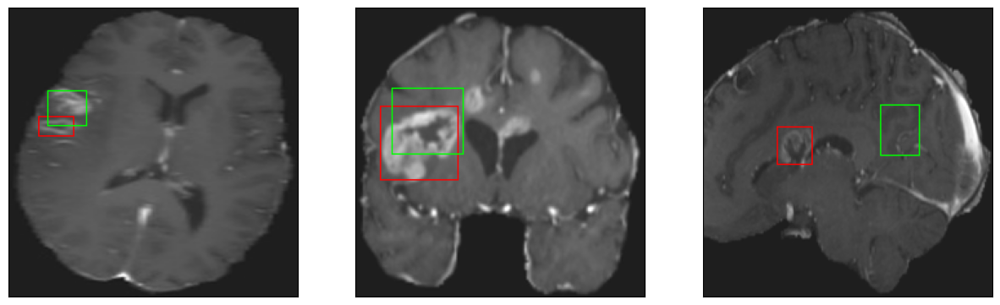

26/26 [==============================] - 3s 108ms/step - loss: 4.9902 - IoU: 0.6167 - val_loss: 8.6977 - val_IoU: 0.5180
Epoch 95/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7526 - IoU: 0.6380
Epoch 95: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


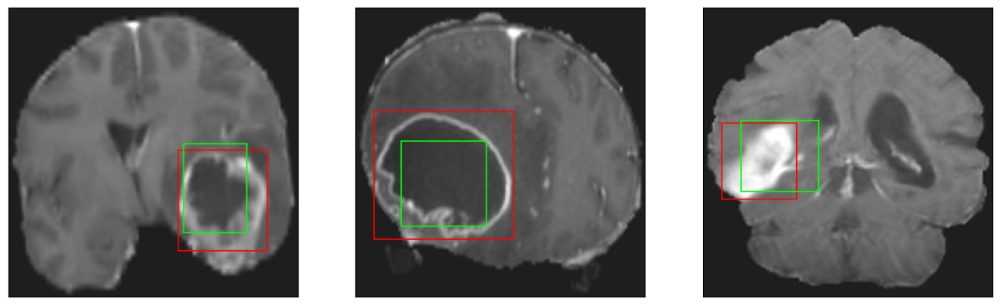

26/26 [==============================] - 3s 124ms/step - loss: 4.7943 - IoU: 0.6353 - val_loss: 9.9942 - val_IoU: 0.4500
Epoch 96/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7352 - IoU: 0.6378
Epoch 96: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


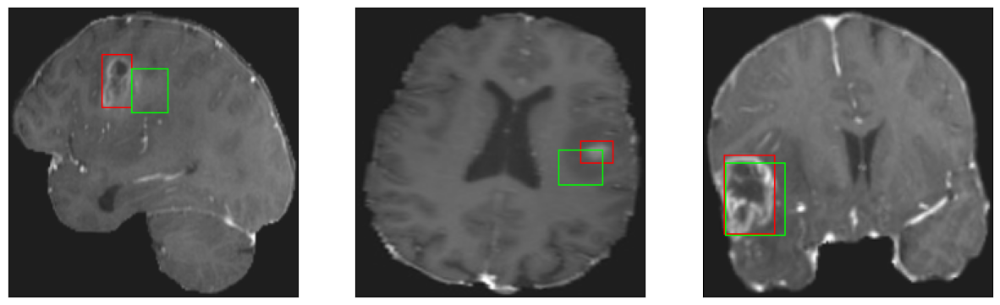

26/26 [==============================] - 3s 106ms/step - loss: 4.6854 - IoU: 0.6400 - val_loss: 8.8174 - val_IoU: 0.5047
Epoch 97/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9641 - IoU: 0.6229
Epoch 97: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


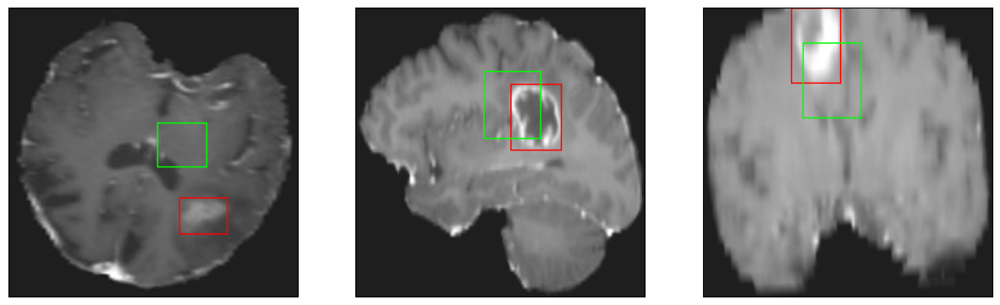

26/26 [==============================] - 3s 103ms/step - loss: 4.9293 - IoU: 0.6238 - val_loss: 13.2585 - val_IoU: 0.3018
Epoch 98/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6771 - IoU: 0.6381
Epoch 98: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


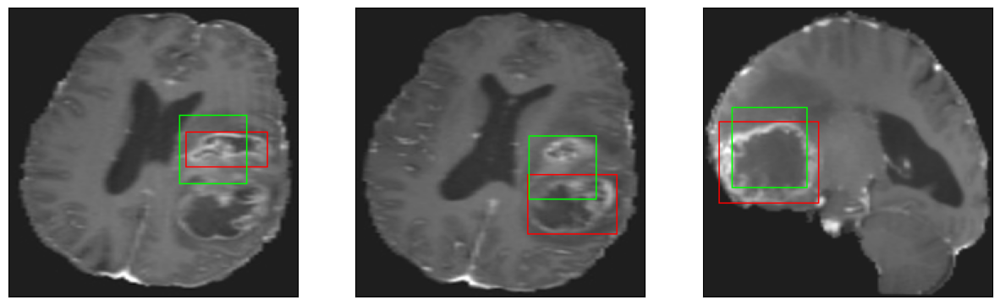

26/26 [==============================] - 3s 134ms/step - loss: 4.6860 - IoU: 0.6390 - val_loss: 10.8317 - val_IoU: 0.3887
Epoch 99/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7952 - IoU: 0.6244
Epoch 99: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


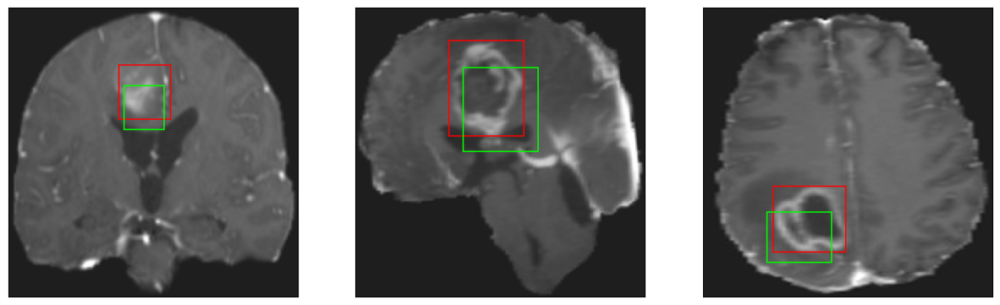

26/26 [==============================] - 3s 123ms/step - loss: 4.7667 - IoU: 0.6247 - val_loss: 9.1312 - val_IoU: 0.4753
Epoch 100/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9394 - IoU: 0.6279
Epoch 100: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


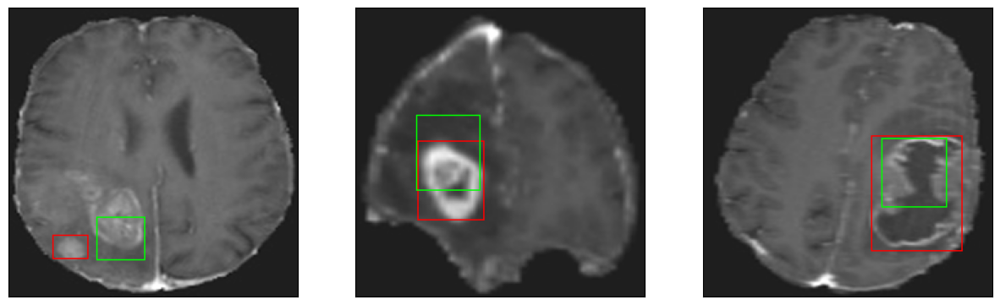

26/26 [==============================] - 3s 106ms/step - loss: 4.8946 - IoU: 0.6292 - val_loss: 8.6707 - val_IoU: 0.5153
Epoch 101/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6825 - IoU: 0.6383
Epoch 101: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


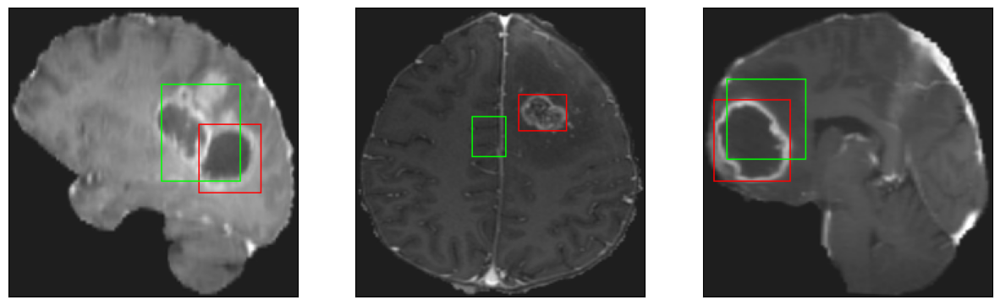

26/26 [==============================] - 3s 109ms/step - loss: 4.6374 - IoU: 0.6403 - val_loss: 9.0480 - val_IoU: 0.5095
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 4.7113 - IoU: 0.6366
Epoch 102: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


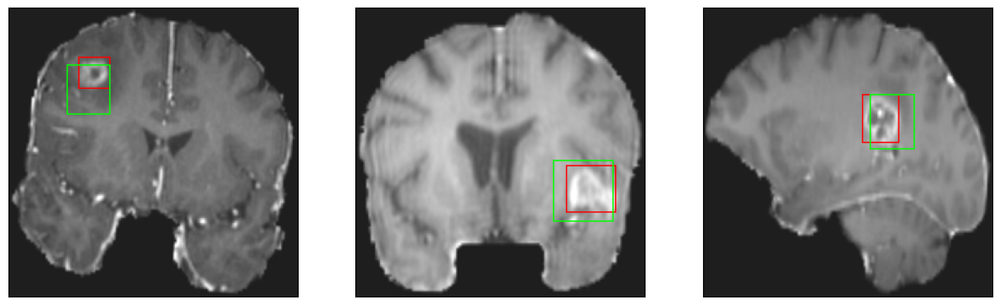

26/26 [==============================] - 4s 148ms/step - loss: 4.7113 - IoU: 0.6366 - val_loss: 8.5568 - val_IoU: 0.5221
Epoch 103/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6285 - IoU: 0.6349
Epoch 103: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


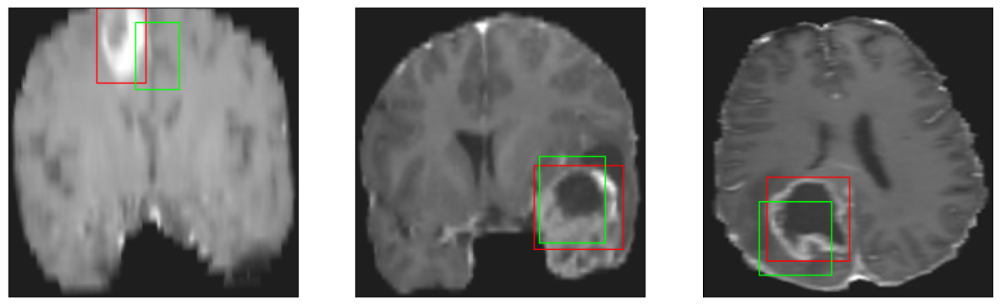

26/26 [==============================] - 3s 113ms/step - loss: 4.6845 - IoU: 0.6323 - val_loss: 8.8870 - val_IoU: 0.5205
Epoch 104/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5231 - IoU: 0.6334
Epoch 104: val_IoU did not improve from 0.53978
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


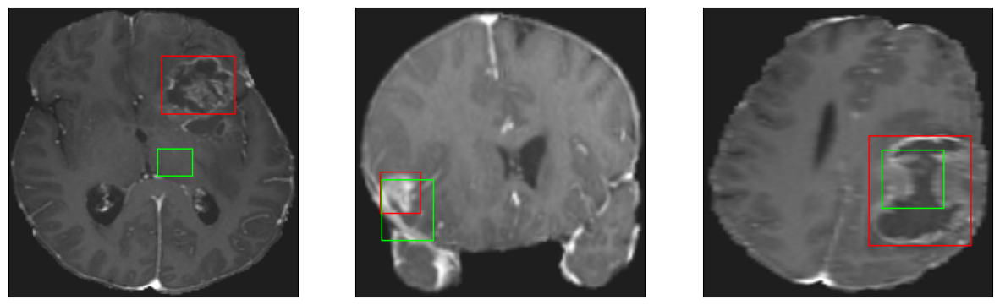

26/26 [==============================] - 3s 109ms/step - loss: 4.4934 - IoU: 0.6352 - val_loss: 8.6197 - val_IoU: 0.5217
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 4.8365 - IoU: 0.6225
Epoch 105: val_IoU improved from 0.53978 to 0.55176, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


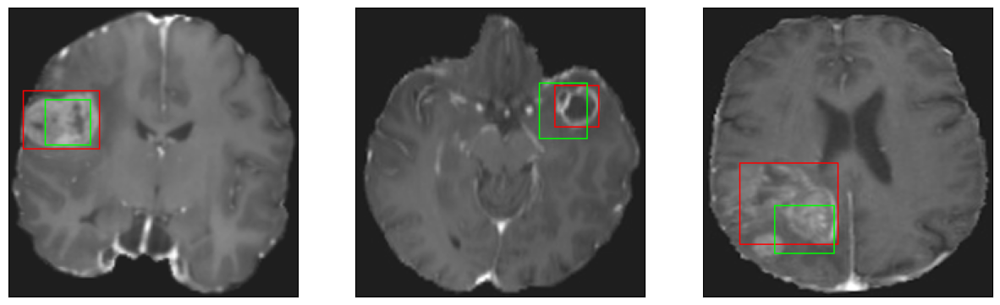

26/26 [==============================] - 4s 158ms/step - loss: 4.8365 - IoU: 0.6225 - val_loss: 8.2210 - val_IoU: 0.5518
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 4.6711 - IoU: 0.6399
Epoch 106: val_IoU improved from 0.55176 to 0.55450, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


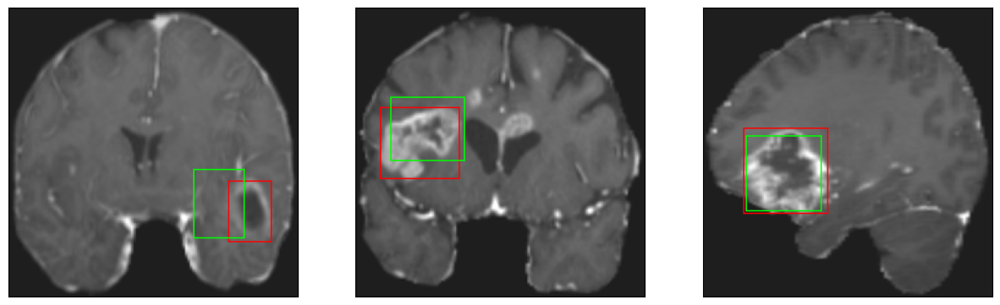

26/26 [==============================] - 3s 114ms/step - loss: 4.6711 - IoU: 0.6399 - val_loss: 8.1412 - val_IoU: 0.5545
Epoch 107/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6280 - IoU: 0.6422
Epoch 107: val_IoU did not improve from 0.55450
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


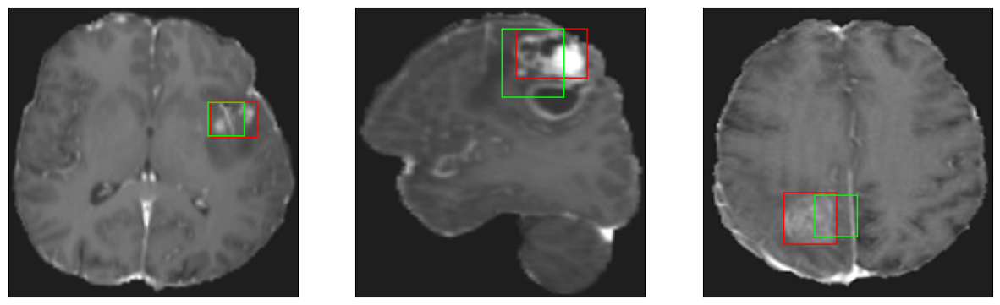

26/26 [==============================] - 3s 97ms/step - loss: 4.6240 - IoU: 0.6434 - val_loss: 8.6281 - val_IoU: 0.5259
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 4.7230 - IoU: 0.6295
Epoch 108: val_IoU did not improve from 0.55450
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


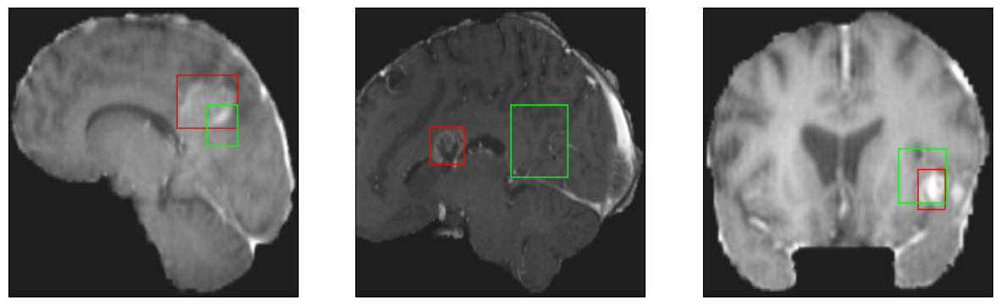

26/26 [==============================] - 3s 109ms/step - loss: 4.7230 - IoU: 0.6295 - val_loss: 8.3108 - val_IoU: 0.5323
Epoch 109/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9121 - IoU: 0.6231
Epoch 109: val_IoU did not improve from 0.55450
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


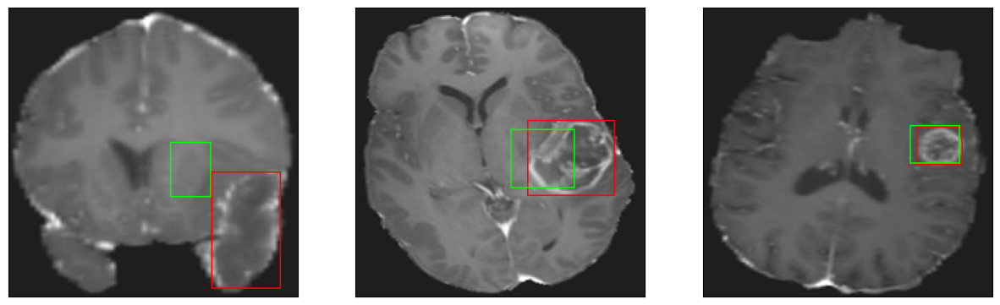

26/26 [==============================] - 3s 133ms/step - loss: 4.8768 - IoU: 0.6259 - val_loss: 10.9715 - val_IoU: 0.3822
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7053 - IoU: 0.6370
Epoch 110: val_IoU did not improve from 0.55450
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


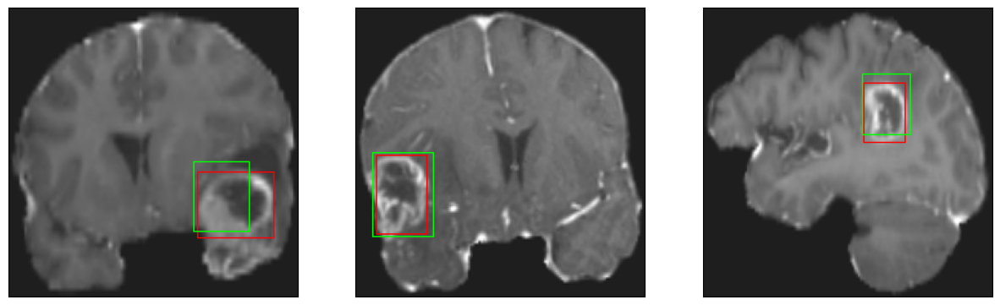

26/26 [==============================] - 3s 114ms/step - loss: 4.6911 - IoU: 0.6375 - val_loss: 9.3958 - val_IoU: 0.4881
Epoch 111/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4486 - IoU: 0.6477
Epoch 111: val_IoU did not improve from 0.55450
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


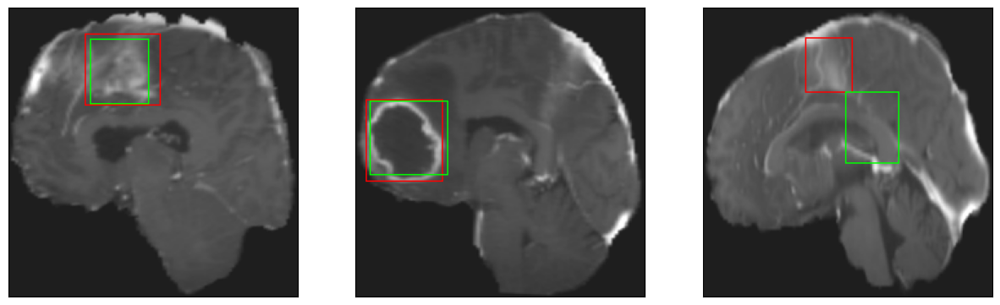

26/26 [==============================] - 3s 107ms/step - loss: 4.4568 - IoU: 0.6491 - val_loss: 8.7119 - val_IoU: 0.5361
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 4.6776 - IoU: 0.6511
Epoch 112: val_IoU did not improve from 0.55450
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


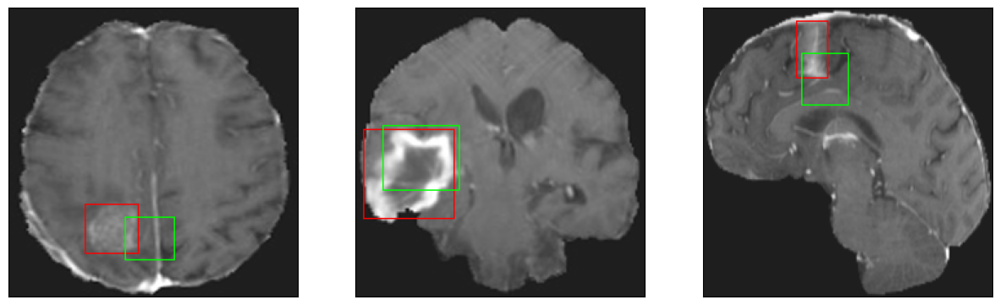

26/26 [==============================] - 4s 137ms/step - loss: 4.6776 - IoU: 0.6511 - val_loss: 9.8313 - val_IoU: 0.4590
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 4.6178 - IoU: 0.6352
Epoch 113: val_IoU did not improve from 0.55450
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


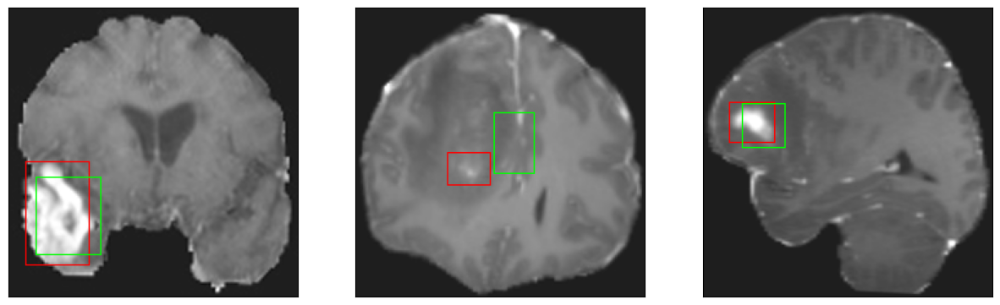

26/26 [==============================] - 3s 104ms/step - loss: 4.6178 - IoU: 0.6352 - val_loss: 9.5927 - val_IoU: 0.4700
Epoch 114/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5643 - IoU: 0.6425
Epoch 114: val_IoU did not improve from 0.55450
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


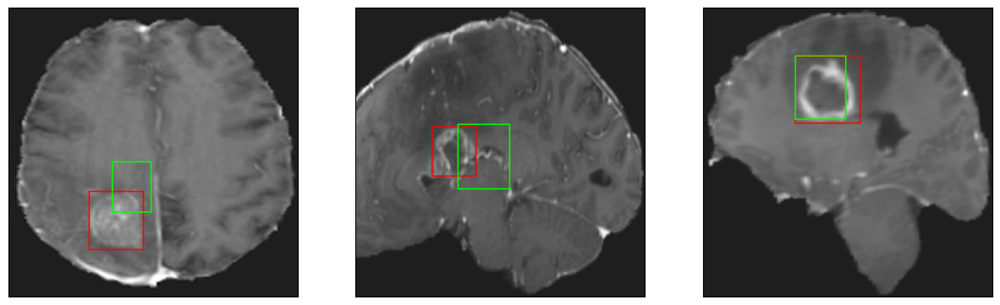

26/26 [==============================] - 3s 106ms/step - loss: 4.5673 - IoU: 0.6436 - val_loss: 10.6548 - val_IoU: 0.4270
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5540 - IoU: 0.6375
Epoch 115: val_IoU did not improve from 0.55450
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


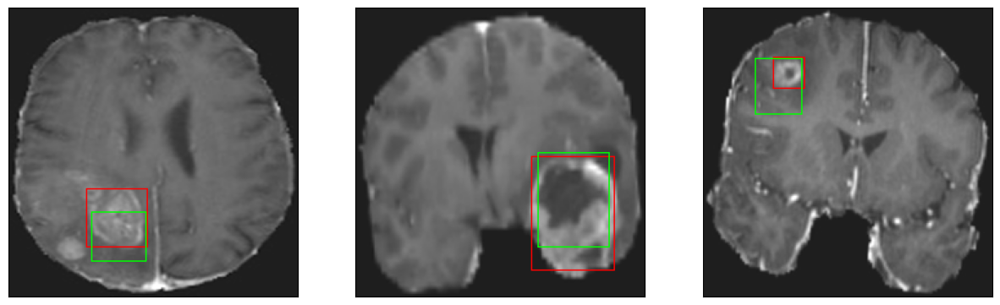

26/26 [==============================] - 3s 120ms/step - loss: 4.5709 - IoU: 0.6373 - val_loss: 8.6353 - val_IoU: 0.5405
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 4.6020 - IoU: 0.6451
Epoch 116: val_IoU did not improve from 0.55450
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


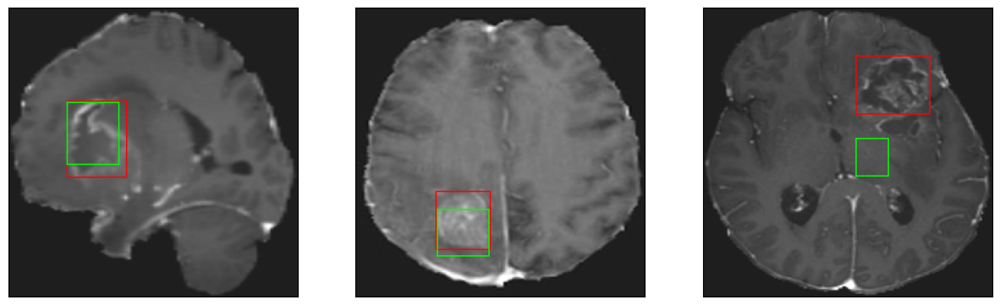

26/26 [==============================] - 3s 117ms/step - loss: 4.6020 - IoU: 0.6451 - val_loss: 8.6800 - val_IoU: 0.5354
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 4.5307 - IoU: 0.6395
Epoch 117: val_IoU did not improve from 0.55450
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


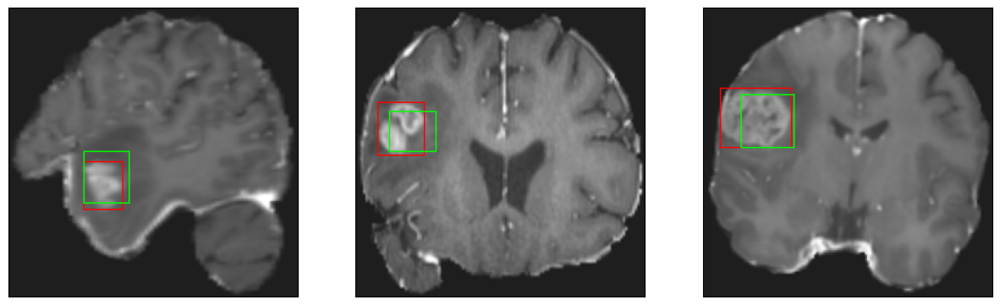

26/26 [==============================] - 3s 110ms/step - loss: 4.5307 - IoU: 0.6395 - val_loss: 9.2079 - val_IoU: 0.4856
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 4.5534 - IoU: 0.6394
Epoch 118: val_IoU improved from 0.55450 to 0.55499, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


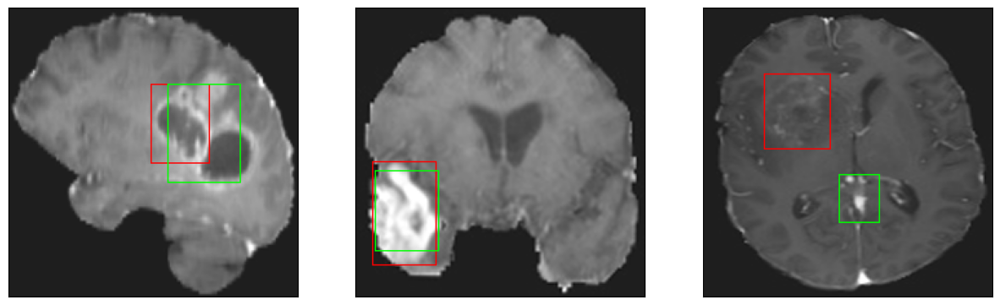

26/26 [==============================] - 4s 137ms/step - loss: 4.5534 - IoU: 0.6394 - val_loss: 8.2811 - val_IoU: 0.5550
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 4.6703 - IoU: 0.6397
Epoch 119: val_IoU did not improve from 0.55499
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


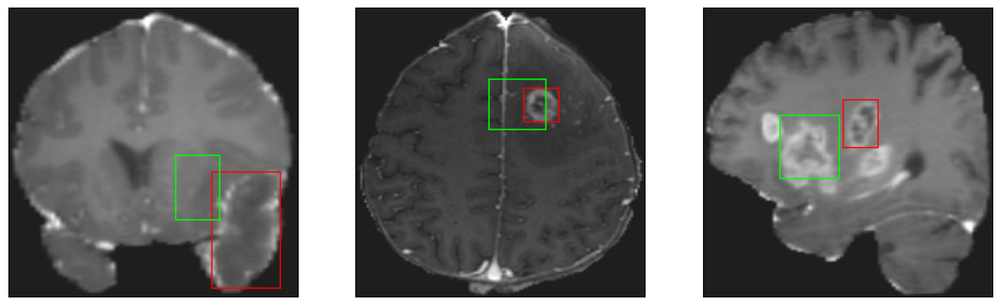

26/26 [==============================] - 3s 115ms/step - loss: 4.6703 - IoU: 0.6397 - val_loss: 8.7453 - val_IoU: 0.5114
Epoch 120/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4075 - IoU: 0.6465
Epoch 120: val_IoU did not improve from 0.55499
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


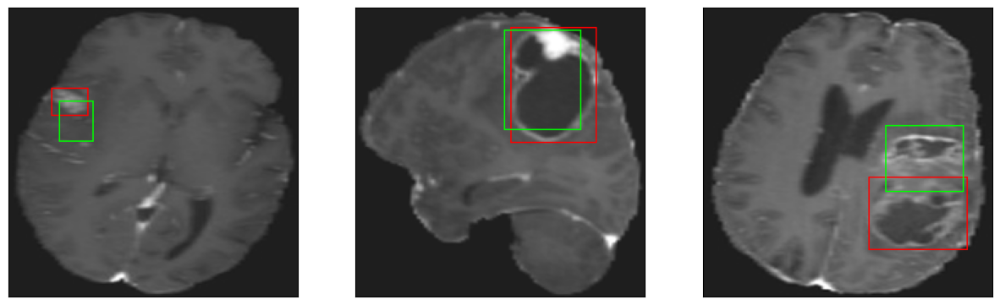

26/26 [==============================] - 3s 107ms/step - loss: 4.4232 - IoU: 0.6466 - val_loss: 8.7922 - val_IoU: 0.5323
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 4.5801 - IoU: 0.6409
Epoch 121: val_IoU did not improve from 0.55499
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


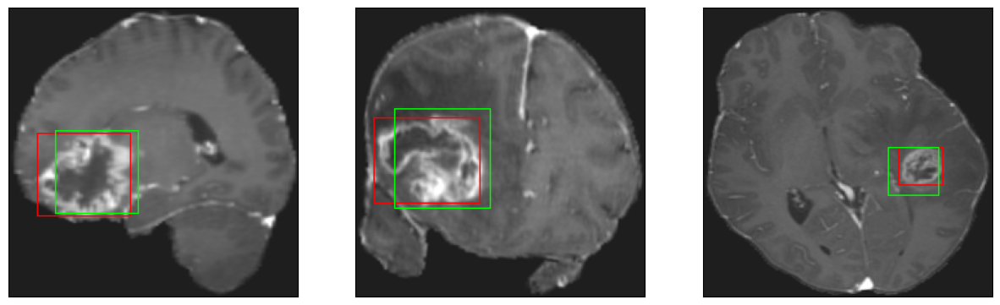

26/26 [==============================] - 3s 122ms/step - loss: 4.5801 - IoU: 0.6409 - val_loss: 8.8780 - val_IoU: 0.5410
Epoch 122/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5884 - IoU: 0.6549
Epoch 122: val_IoU did not improve from 0.55499
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


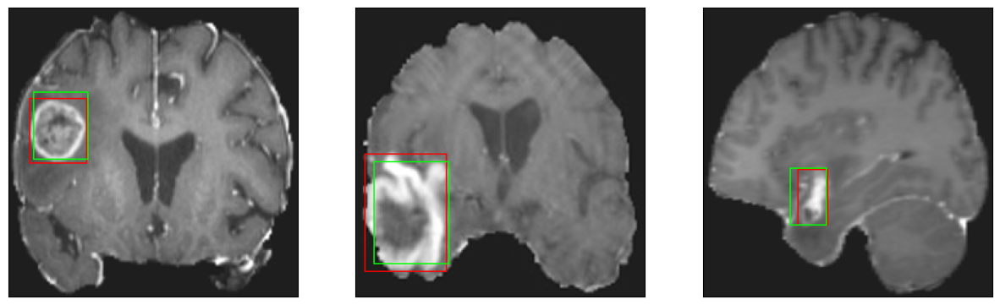

26/26 [==============================] - 3s 130ms/step - loss: 4.5489 - IoU: 0.6557 - val_loss: 8.4471 - val_IoU: 0.5354
Epoch 123/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6028 - IoU: 0.6399
Epoch 123: val_IoU did not improve from 0.55499
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


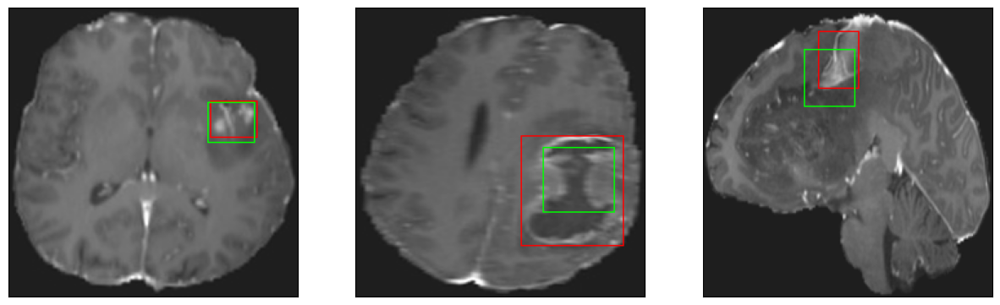

26/26 [==============================] - 3s 110ms/step - loss: 4.6120 - IoU: 0.6403 - val_loss: 8.8785 - val_IoU: 0.5194
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 4.4724 - IoU: 0.6520
Epoch 124: val_IoU did not improve from 0.55499
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


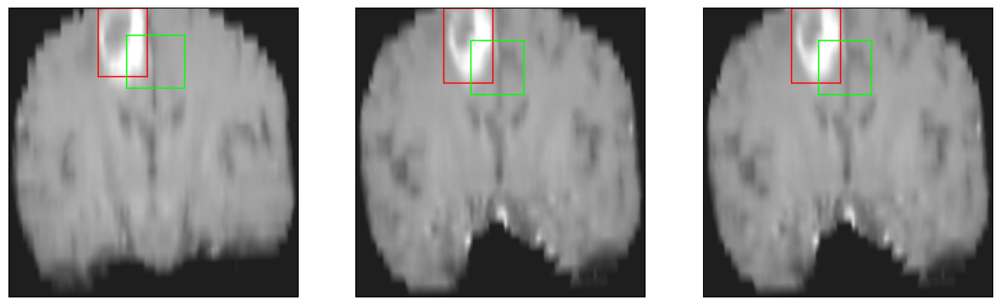

26/26 [==============================] - 3s 122ms/step - loss: 4.4724 - IoU: 0.6520 - val_loss: 10.5151 - val_IoU: 0.4300
Epoch 125/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7389 - IoU: 0.6221
Epoch 125: val_IoU did not improve from 0.55499
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


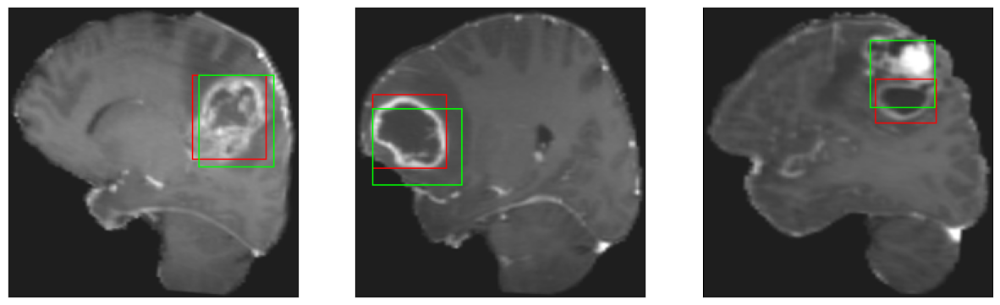

26/26 [==============================] - 3s 124ms/step - loss: 4.7481 - IoU: 0.6233 - val_loss: 9.6814 - val_IoU: 0.4576
Epoch 126/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3880 - IoU: 0.6525
Epoch 126: val_IoU did not improve from 0.55499
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


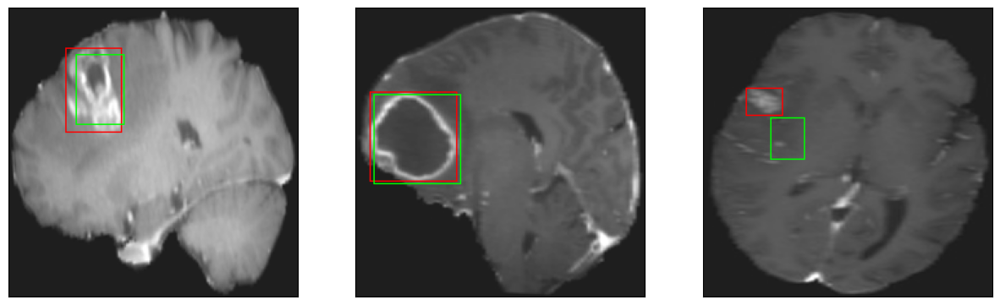

26/26 [==============================] - 3s 110ms/step - loss: 4.3955 - IoU: 0.6525 - val_loss: 8.8923 - val_IoU: 0.5232
Epoch 127/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5385 - IoU: 0.6435
Epoch 127: val_IoU did not improve from 0.55499
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


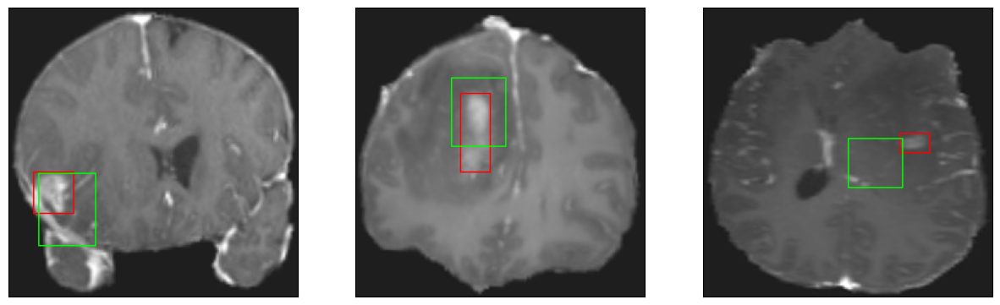

26/26 [==============================] - 3s 103ms/step - loss: 4.5377 - IoU: 0.6441 - val_loss: 9.3524 - val_IoU: 0.4818
Epoch 128/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3991 - IoU: 0.6489
Epoch 128: val_IoU improved from 0.55499 to 0.56711, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


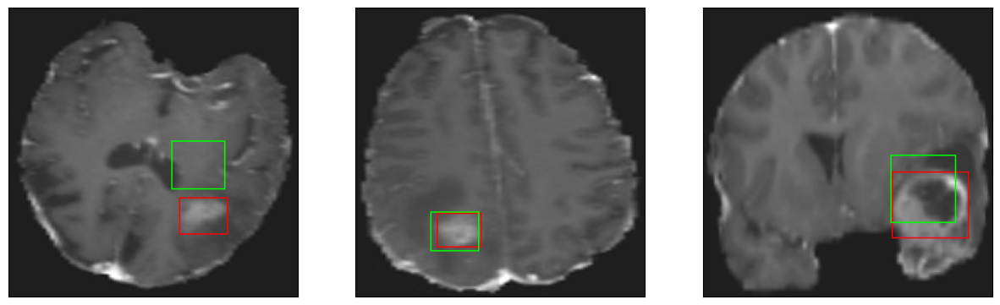

26/26 [==============================] - 3s 132ms/step - loss: 4.4201 - IoU: 0.6472 - val_loss: 7.9841 - val_IoU: 0.5671
Epoch 129/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4876 - IoU: 0.6424
Epoch 129: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


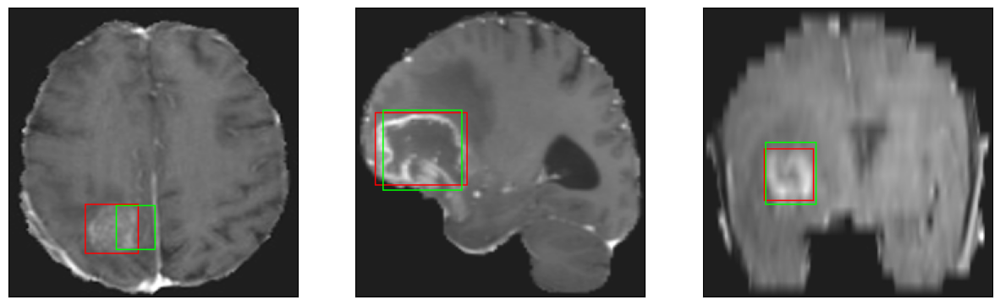

26/26 [==============================] - 3s 128ms/step - loss: 4.5442 - IoU: 0.6402 - val_loss: 8.3859 - val_IoU: 0.5376
Epoch 130/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4985 - IoU: 0.6411
Epoch 130: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


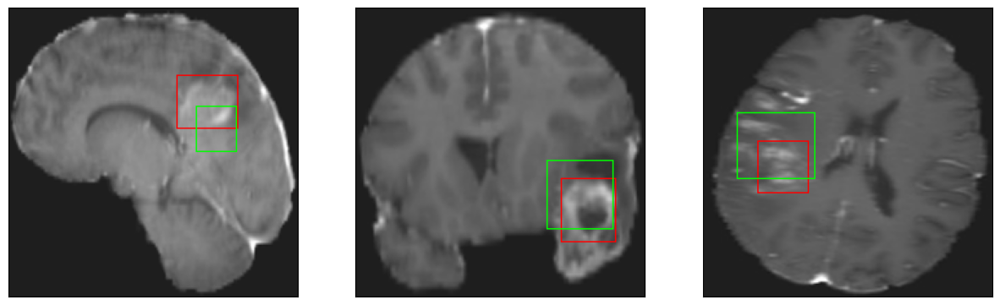

26/26 [==============================] - 3s 123ms/step - loss: 4.5227 - IoU: 0.6402 - val_loss: 8.8108 - val_IoU: 0.5401
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 4.5419 - IoU: 0.6383
Epoch 131: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


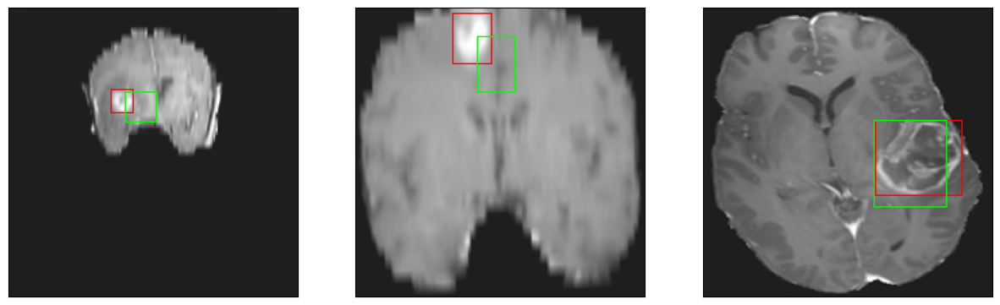

26/26 [==============================] - 3s 109ms/step - loss: 4.5419 - IoU: 0.6383 - val_loss: 9.0885 - val_IoU: 0.5164
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 4.6613 - IoU: 0.6370
Epoch 132: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


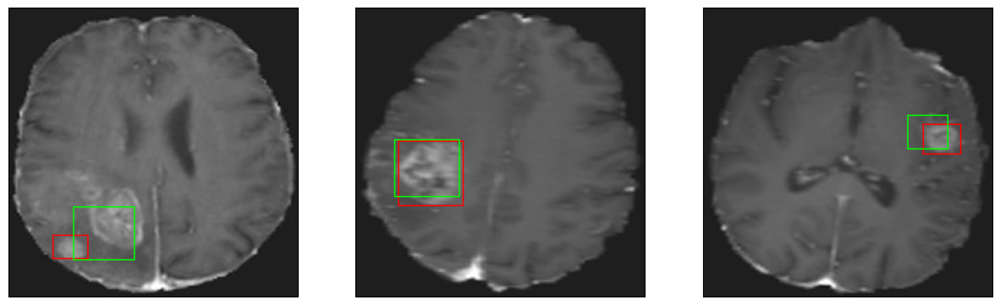

26/26 [==============================] - 3s 107ms/step - loss: 4.6613 - IoU: 0.6370 - val_loss: 8.2073 - val_IoU: 0.5532
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 4.5734 - IoU: 0.6439
Epoch 133: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


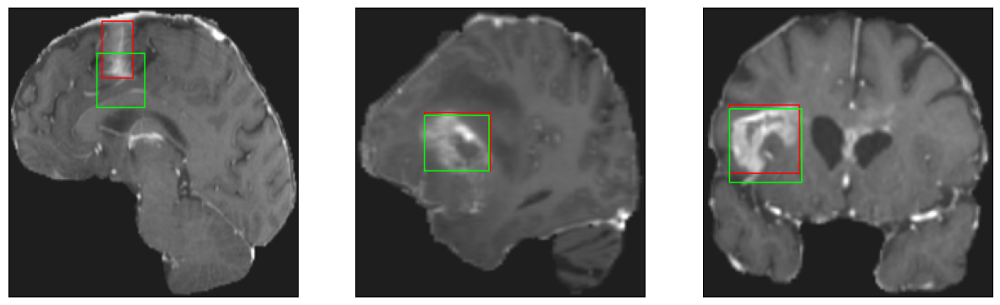

26/26 [==============================] - 3s 133ms/step - loss: 4.5734 - IoU: 0.6439 - val_loss: 8.8996 - val_IoU: 0.4976
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6430 - IoU: 0.6329
Epoch 134: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


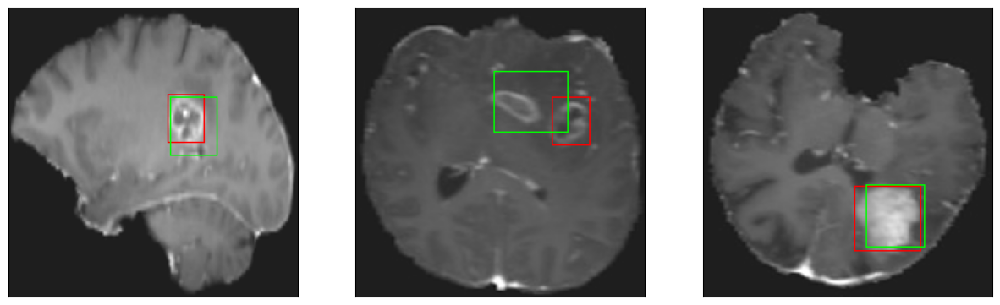

26/26 [==============================] - 3s 110ms/step - loss: 4.6032 - IoU: 0.6342 - val_loss: 9.0442 - val_IoU: 0.4857
Epoch 135/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3665 - IoU: 0.6519
Epoch 135: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


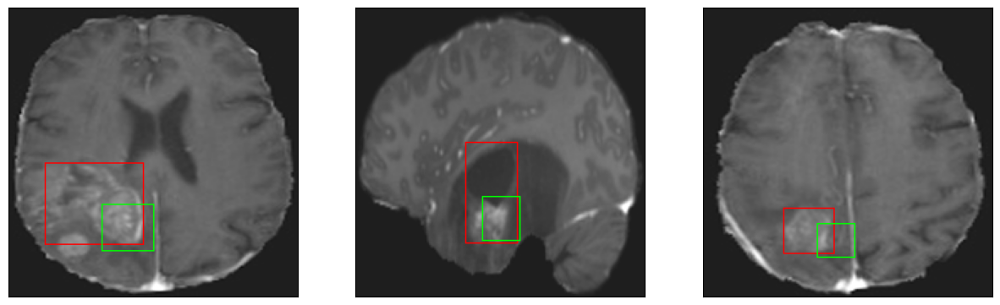

26/26 [==============================] - 3s 101ms/step - loss: 4.3273 - IoU: 0.6539 - val_loss: 8.5069 - val_IoU: 0.5208
Epoch 136/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4345 - IoU: 0.6475
Epoch 136: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


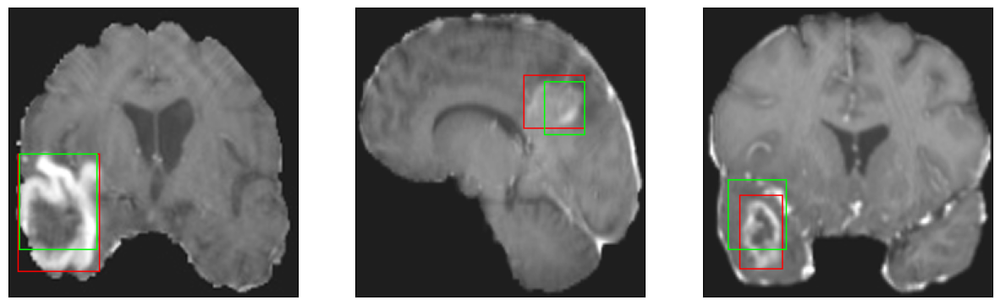

26/26 [==============================] - 3s 123ms/step - loss: 4.4326 - IoU: 0.6479 - val_loss: 9.3674 - val_IoU: 0.4705
Epoch 137/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4407 - IoU: 0.6475
Epoch 137: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 13ms/step
4


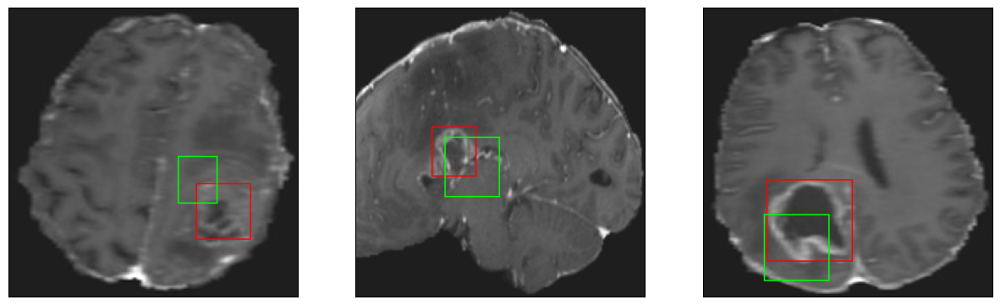

26/26 [==============================] - 3s 125ms/step - loss: 4.4117 - IoU: 0.6498 - val_loss: 8.3524 - val_IoU: 0.5605
Epoch 138/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4469 - IoU: 0.6479
Epoch 138: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


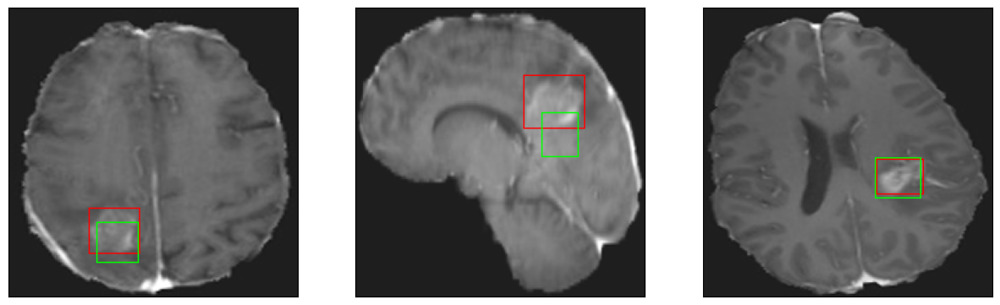

26/26 [==============================] - 3s 107ms/step - loss: 4.4309 - IoU: 0.6502 - val_loss: 8.0561 - val_IoU: 0.5661
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 4.3625 - IoU: 0.6535
Epoch 139: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


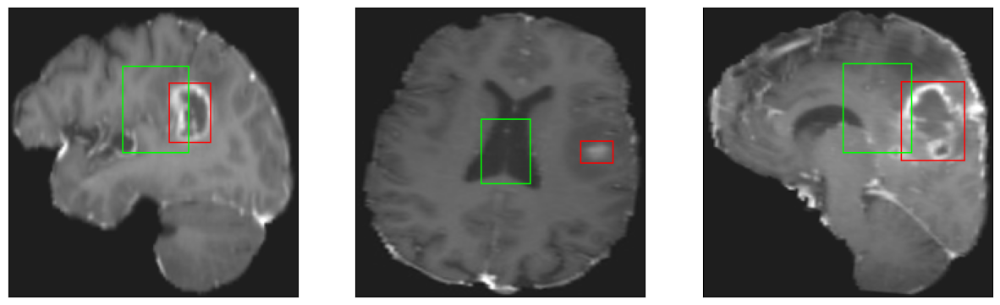

26/26 [==============================] - 3s 112ms/step - loss: 4.3625 - IoU: 0.6535 - val_loss: 17.6444 - val_IoU: 0.2466
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 4.5938 - IoU: 0.6347
Epoch 140: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


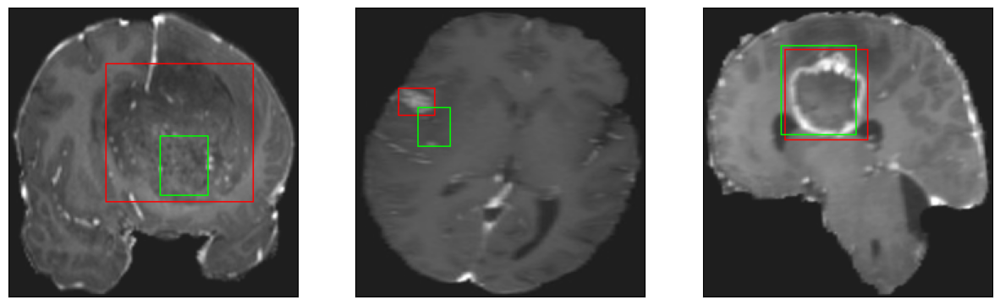

26/26 [==============================] - 3s 113ms/step - loss: 4.5938 - IoU: 0.6347 - val_loss: 8.9845 - val_IoU: 0.5031
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 4.5814 - IoU: 0.6379
Epoch 141: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


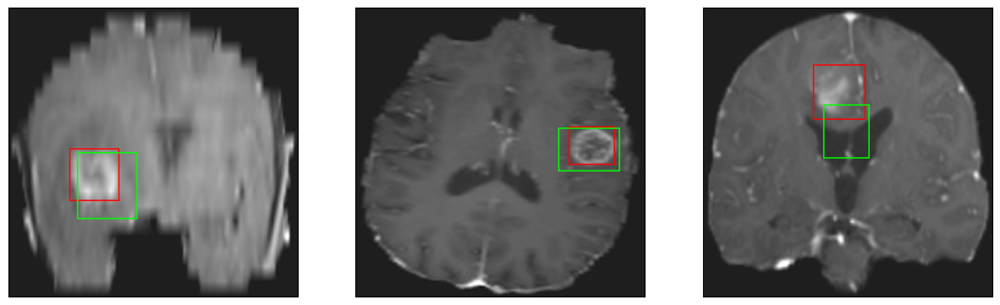

26/26 [==============================] - 3s 122ms/step - loss: 4.5814 - IoU: 0.6379 - val_loss: 8.8271 - val_IoU: 0.5327
Epoch 142/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1842 - IoU: 0.6613
Epoch 142: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


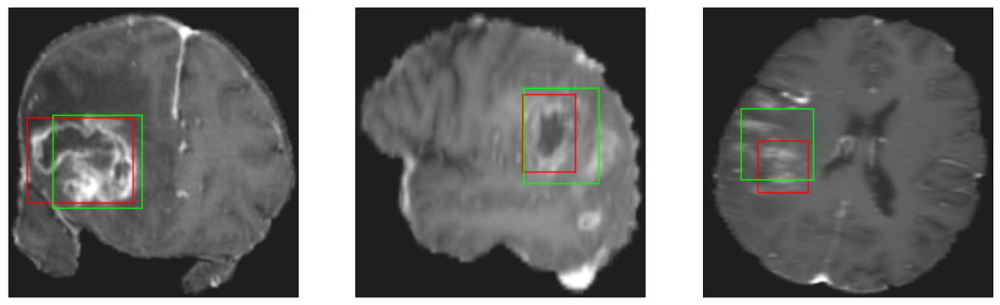

26/26 [==============================] - 3s 103ms/step - loss: 4.1817 - IoU: 0.6619 - val_loss: 8.2511 - val_IoU: 0.5645
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 4.5420 - IoU: 0.6420
Epoch 143: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


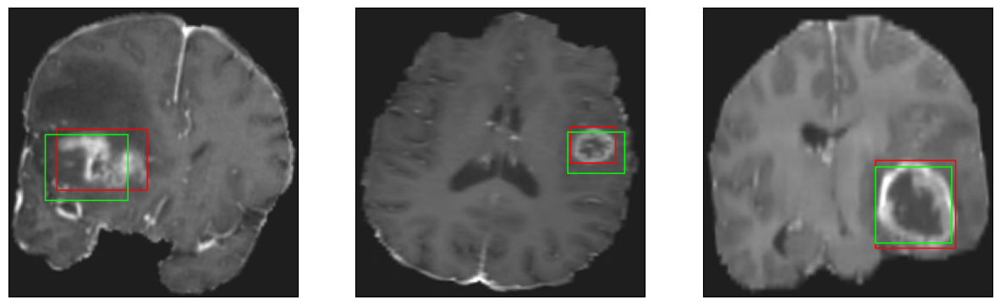

26/26 [==============================] - 3s 122ms/step - loss: 4.5420 - IoU: 0.6420 - val_loss: 8.4402 - val_IoU: 0.5509
Epoch 144/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4416 - IoU: 0.6538
Epoch 144: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


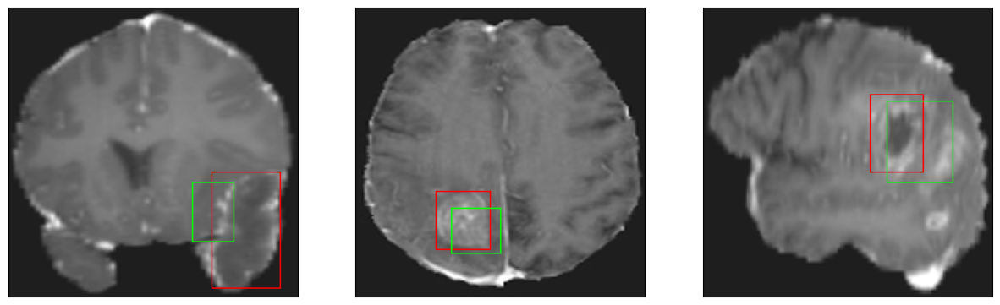

26/26 [==============================] - 3s 107ms/step - loss: 4.4159 - IoU: 0.6543 - val_loss: 8.5761 - val_IoU: 0.5514
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 4.4259 - IoU: 0.6451
Epoch 145: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


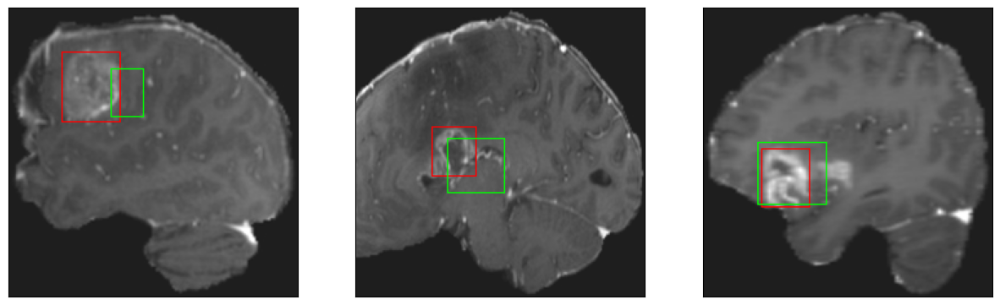

26/26 [==============================] - 3s 128ms/step - loss: 4.4259 - IoU: 0.6451 - val_loss: 8.0238 - val_IoU: 0.5520
Epoch 146/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3533 - IoU: 0.6483
Epoch 146: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


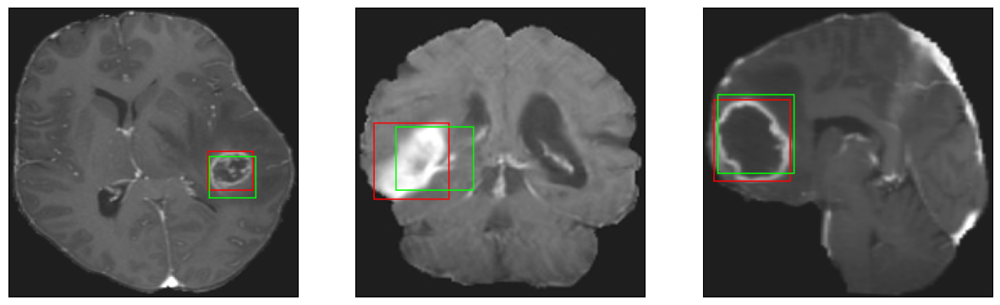

26/26 [==============================] - 3s 127ms/step - loss: 4.4561 - IoU: 0.6453 - val_loss: 9.1884 - val_IoU: 0.5034
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 4.6345 - IoU: 0.6327
Epoch 147: val_IoU did not improve from 0.56711
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


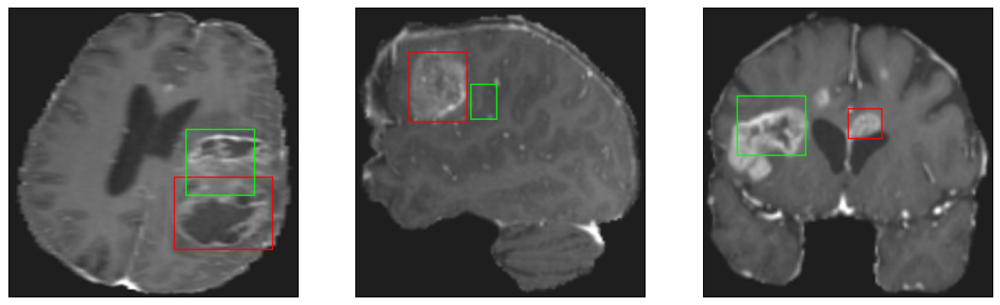

26/26 [==============================] - 3s 113ms/step - loss: 4.6345 - IoU: 0.6327 - val_loss: 9.0109 - val_IoU: 0.4970
Epoch 148/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5950 - IoU: 0.6330
Epoch 148: val_IoU did not improve from 0.56711
Restoring model weights from the end of the best epoch: 128.
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


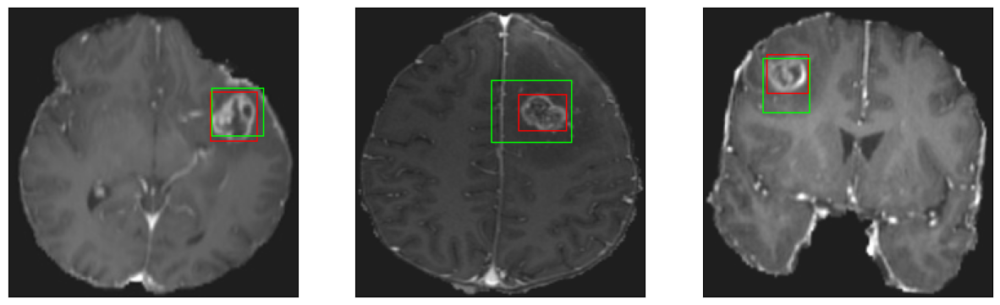

26/26 [==============================] - 3s 119ms/step - loss: 4.5855 - IoU: 0.6337 - val_loss: 8.3749 - val_IoU: 0.5281
Epoch 148: early stopping


In [24]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

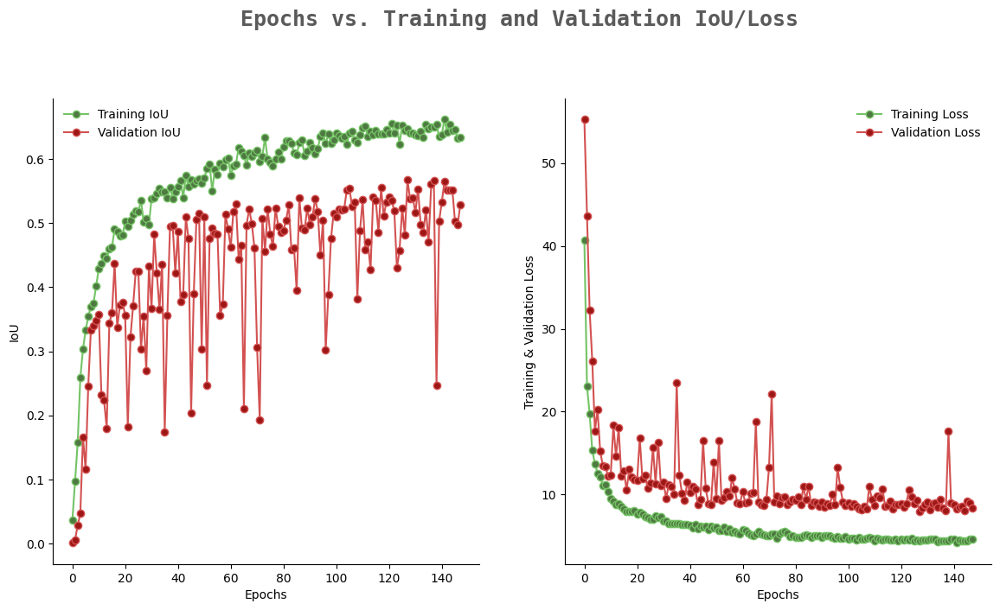

In [26]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(148)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [27]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [28]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [29]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 24ms/step - loss: 10.2140 - IoU: 0.4664


[10.213964462280273, 0.4663521945476532]